# Problem 2 - Generative Adversarial Networks (GAN)


* **Learning Objective**: In this problem, you will implement a Generative 
Adversarial Network with the network structure proposed in [Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks](https://arxiv.org/pdf/1511.06434.pdf). You will also learn a visualization technique: activation maximization.
* **Provided code**: The code for constructing the two parts of the GAN, the discriminator and the generator, is done for you, along with the skeleton code for the training.
* **TODOs**: You will need to figure out how to define the training loop, compute the loss, and update the parameters to complete the training and visualization. In addition, to test your understanding, you will answer some non-coding written questions. Please see details below.

**Note**: 


* If you use the Colab, for faster training of the models in this assignment, you can enable GPU support in the Colab. Navigate to "Runtime" --> "Change Runtime Type" and set the "Hardware Accelerator" to "GPU". **However, Colab has the GPU limit, so be discretional with your GPU usage.**
* If you run into CUDA errors in the Colab, check your code carefully. After fixing your code, if the CUDA error shows up at a previously correct line, restart the Colab. However, this is not a fix to all your CUDA issues. Please check your implementation carefully.



In [1]:
# Import required libraries
import torch.nn as nn
import torch
import numpy as np
import matplotlib.pyplot as plt
import math
from torchvision.utils import make_grid
%matplotlib inline

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

# **Introduction: The forger versus the police**
**Please read the information below even if you are familiar with GANs. There are some terms below that will be used in the coding part.**

Generative models try to model the distribution of the data in an explicit way, in the sense that we can easily sample new data points from this model. This is in contrast to discriminative models that try to infer the output from the input. In class and in the previous problem, we have seen one classic deep generative model, the Variational Autoencoder (VAE). Here, we will learn another generative model that has risen to prominence in recent years, the Generative Adversarial Network (GAN).

As the math of Generative Adversarial Networks are somewhat tedious, a story is often told of a forger and a police officer to illustrate the idea.



> Imagine a forger that makes fake bills, and a police officer that tries to find these forgeries. If the forger were a VAE, his goal would be to take some real bills, and try to replicate the real bills as precisely as possible. With GANs, the forger has a different idea: rather than trying to replicate the real bills, it suffices to make fake bills such that people think they are real.

> Now let's start. In the beginning, the police knows nothing about how to distinguish between real and fake bills. The forger knows nothing either and only produces white paper.

> In the first round, the police gets the fake bill and learns that the forgeries are white while the real bills are green. The forger then finds out that white papers can no longer fool the police and starts to produce green papers.

> In the second round, the police learns that real bills have denominations printed on them while the forgeries do not. The forger then finds out that plain papers can no longer fool the police and starts to print numbers on them.

> In the third round, the police learns that real bills have watermarks on them while the forgeries do not. The forger then has to reproduce the watermarks on his fake bills.

> ...

> Finally, the police is able to spot the tiniest difference between real and fake bills and the forger has to make perfect replicas of real bills to fool the police.

Now in a GAN, the forger becomes the generator and the police becomes the discriminator. The discriminator is a binary classifier with the two classes being "taken from the real data" ("real") and "generated by the generator" ("fake"). Its objective is to minimize the classification loss. The generator's objective is to generate samples so that the discriminator misclassifies them as real.

Here we have some complications: the goal is not to find one perfect fake sample. Such a sample will not actually fool the discriminator: if the forger makes hundreds of the exact same fake bill, they will all have the same serial number and the police will soon find out that they are fake. Instead, we want the generator to be able to generate a variety of fake samples such that when presented as a distribution alongside the distribution of real samples, these two are indistinguishable by the discriminator.

So how do we generate different samples with a deterministic generator? We provide it with random numbers as input.


Typically, for the discriminator we use *binary cross entropy loss* with label 1 being real and 0 being fake. For the generator, the input is a random vector drawn from a standard normal distribution. Denote the generator by $G_\phi(z)$, discriminator by $D_\theta (x)$, the distribution of the real samples by $p(x)$, and the input distribution to the generator by $q(z)$. Recall that the binary cross entropy loss with classifier output $y$ and label $\hat{y}$ is 

$$L(y, \hat{y}) = -\hat{y} \log y - (1 - \hat{y}) \log (1 - y)$$

For the discriminator, the objective is 
$$\min_{\theta} \mathrm{E}_{x \sim p(x)}[L(D_{\theta}(x), 1)] + \mathrm{E}_{z \sim q(z)}[L(D_{\theta}(G_{\phi}(z)), 0)]$$

For the generator, the objective is 
$$\max_{\phi} \mathrm{E}_{z \sim q(z)}[L(D_{\theta}(G_{\phi}(z)), 0)]$$

The generator's objective corresponds to maximizing the classification loss of the discriminator on the generated samples. Alternatively, we can **minimize** the *classification loss* of the discriminator on the generated samples **when labelled as real:**
$$\min_{\phi} \mathrm{E}_{z \sim q(z)}[L(D_{\theta}(G_{\phi}(z)), 1)]$$

And this is what we will use in our implementation. The strength of the two networks should be balanced, so we train the two networks alternatingly, updating the parameters in both networks once in each iteration.

# **Problem 2-1: Implementing the GAN (20 pts)**

Correctly filling out `__init__`: 7 pts

Correctly filling out training loop: 13 pts

We first load the data (CIFAR-10) and define some convenient functions. You can run the cell below to download the dataset to `./data`.

In [2]:
# !wget http://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz -P data
# !tar -xzvf data/cifar-10-python.tar.gz --directory data
# !rm data/cifar-10-python.tar.gz

In [3]:
def unpickle(file):
    import sys
    if sys.version_info.major == 2:
        import cPickle
        with open(file, 'rb') as fo:
            dict = cPickle.load(fo)
        return dict['data'], dict['labels']
    else:
        import pickle
        with open(file, 'rb') as fo:
            dict = pickle.load(fo, encoding='bytes')
        return dict[b'data'], dict[b'labels']
def load_train_data():
    X = []
    for i in range(5):
        X_, _ = unpickle('data/cifar-10-batches-py/data_batch_%d' % (i + 1))
        X.append(X_)
    X = np.concatenate(X)
    X = X.reshape((X.shape[0], 3, 32, 32))
    return X

def load_test_data():
    X_, _ = unpickle('data/cifar-10-batches-py/test_batch')
    X = X_.reshape((X_.shape[0], 3, 32, 32))
    return X

def set_seed(seed):
    np.random.seed(seed)
    torch.manual_seed(seed)

# Load cifar-10 data
train_samples = load_train_data() / 255.0
test_samples= load_test_data() / 255.0

To save you some mundane work, we have defined a discriminator and a generator for you. Look at the code to see what layers are there.

##**For this part, you need to complete code blocks marked with "Prob 2-1":**

* **Build the Discriminator and Generator, define the loss objectives** 
* **Define the optimizers** 
* **Build the training loop and compute the losses**: As per [How to Train a GAN? Tips and tricks to make GANs work](https://urldefense.com/v3/__https://github.com/soumith/ganhacks__;!!LIr3w8kk_Xxm!_OyEq6RR8H2WeaK3_oOAGVDF3QgpTm6kRTMtpMyD8QNo1-3RJzf5a8HAGSXVdQ$), we put real samples and fake samples in different batches when training the discriminator.

Note: use the advice on that page with caution if you are using GANs for your team project. It is already 4 years old, which is a really long time in deep learning research. It does not reflect the latest results.


In [4]:
class Generator(nn.Module):
    def __init__(self, starting_shape):
        super(Generator, self).__init__()
        self.fc = nn.Linear(starting_shape, 4 * 4 * 128)
        self.upsample_and_generate = nn.Sequential(
            nn.BatchNorm2d(128),
            nn.LeakyReLU(),
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1, bias=True),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(),
            nn.ConvTranspose2d(in_channels=64, out_channels=32, kernel_size=4, stride=2, padding=1, bias=True),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(),
            nn.ConvTranspose2d(in_channels=32, out_channels=3, kernel_size=4, stride=2, padding=1, bias=True),
            nn.Sigmoid()
        )
    def forward(self, input):
        transformed_random_noise = self.fc(input)
        reshaped_to_image = transformed_random_noise.reshape((-1, 128, 4, 4))
        generated_image = self.upsample_and_generate(reshaped_to_image)
        return generated_image

In [5]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.downsample = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=32, kernel_size=4, stride=2, padding=1, bias=True),
            nn.LeakyReLU(),
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=4, stride=2, padding=1, bias=True),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=True),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(),
        )
        self.fc = nn.Linear(4 * 4 * 128, 1)
    def forward(self, input):
        downsampled_image = self.downsample(input)
        reshaped_for_fc = downsampled_image.reshape((-1, 4 * 4 * 128))
        classification_probs = self.fc(reshaped_for_fc)
        return classification_probs

In [6]:
# Use this to put tensors on GPU/CPU automatically when defining tensors
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu') 

class DCGAN(nn.Module):
    def __init__(self):
        super(DCGAN, self).__init__()
        self.num_epoch = 25
        self.batch_size = 128
        self.log_step = 100 
        self.visualize_step = 2 
        self.code_size = 64  # size of latent vector (size of generator input)
        self.learning_rate = 2e-4
        self.vis_learning_rate = 1e-2
        
        # IID N(0, 1) Sample
        self.tracked_noise = torch.randn([64, self.code_size], device=device)        
        
        self._actmax_label = torch.ones([64, 1], device=device)
        
        ################################################################################
        # Prob 2-1: Define the generator and discriminator, and loss functions  #
        # Also, apply the custom weight initialization (see link:                      #
        # https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html)            #
        ################################################################################
        # To-Do: Initialize generator and discriminator
        # use variable name "self._generator" and "self._discriminator", respectively
        # (also move them to torch device for accelerating the training later)
        self._generator = Generator(self.code_size).to(device)
        self._discriminator = Discriminator().to(device)



        # To-Do: Apply weight initialization (first implement the weight initialization 
        # function below by following the given link)
        self._generator.apply(self._weight_initialization)
        self._discriminator.apply(self._weight_initialization)

        ################################################################################
        # Prob 2-1: Define the generator and discriminators' optimizers                #
        # HINT: Use Adam, and the provided momentum values (betas)                     #
        ################################################################################
        betas = (0.5, 0.999)
        # To-Do: Initialize the generator's and discriminator's optimizers

        self.optimizerD = torch.optim.Adam(self._discriminator.parameters(), lr=self.learning_rate, betas=betas)
        self.optimizerG = torch.optim.Adam(self._generator.parameters(), lr=self.learning_rate, betas=betas)



        


    # To-Do: Define weight initialization function
    # see link: https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
    def _weight_initialization(self, m):
        classname = m.__class__.__name__
        if classname.find('Conv') != -1:
            nn.init.normal_(m.weight.data, 0.0, 0.02)
        elif classname.find('BatchNorm') != -1:
            nn.init.normal_(m.weight.data, 1.0, 0.02)
            nn.init.constant_(m.bias.data, 0)



    # To-Do: Define a general classification loss function (sigmoid followed by binary cross entropy loss)
    def _classification_loss(self):
        loss = nn.BCEWithLogitsLoss()
        return loss

        ################################################################################
        #                               END OF YOUR CODE                               #
        ################################################################################

    # Training function
    def train(self, train_samples):
        num_train = train_samples.shape[0]
        step = 0
        
        # smooth the loss curve so that it does not fluctuate too much
        smooth_factor = 0.95
        plot_dis_s = 0
        plot_gen_s = 0
        plot_ws = 0
        
        dis_losses = []
        gen_losses = []
        max_steps = int(self.num_epoch * (num_train // self.batch_size))
        fake_label = torch.zeros([self.batch_size, 1], device=device)
        real_label = torch.ones([self.batch_size, 1], device=device)
        self._generator.train()
        self._discriminator.train()
        print('Start training ...')
        for epoch in range(self.num_epoch):
            np.random.shuffle(train_samples)
            for i in range(num_train // self.batch_size):
                step += 1

                batch_samples = train_samples[i * self.batch_size : (i + 1) * self.batch_size]
                batch_samples = torch.Tensor(batch_samples).to(device)

                ################################################################################
                # Prob 2-1: Train the discriminator on all real images first            #
                ################################################################################
                # To-Do: HINT: Remember to eliminate all discriminator gradients first! (.zero_grad())
                self._discriminator.zero_grad()

                # To-Do: feed real samples to the discriminator

                output = self._discriminator(batch_samples)



                # To-Do: calculate the discriminator loss for real samples
                # use the variable name "real_dis_loss"
                real_dis_loss = self._classification_loss()(output, real_label)



                ################################################################################
                # Prob 2-1: Train the discriminator with an all fake batch                     #
                ################################################################################   
                # To-Do: sample noises from IID Normal(0, 1)^d on the torch device
                noise = torch.randn([self.batch_size, self.code_size], device=device)


                # To-Do: generate fake samples from the noise using the generator
                fake_samples = self._generator(noise)
    


                # To-Do: feed fake samples to discriminator
                # Make sure to detach the fake samples from the gradient calculation 
                # when feeding to the discriminator, we don't want the discriminator to 
                # receive gradient info from the Generator

                output = self._discriminator(fake_samples.detach())


                # To-Do: calculate the discriminator loss for fake samples
                # use the variable name "fake_dis_loss"

                fake_dis_loss = self._classification_loss()(output, fake_label)


                # To-Do: calculate the total discriminator loss (real loss + fake loss)

                dis_loss = real_dis_loss + fake_dis_loss
                
                # To-Do: calculate the gradients for the total discriminator loss

                dis_loss.backward()


                # To-Do: update the discriminator weights

                self.optimizerD.step()
                
                
                
                ################################################################################
                # Prob 2-1: Train the generator                                                #
                ################################################################################                
                # To-Do: Remember to eliminate all generator gradients first! (.zero_grad())
                self._generator.zero_grad()

    
                # To-Do: sample noises from IID Normal(0, 1)^d on the torch device
                noise = torch.randn([self.batch_size, self.code_size], device=device)


                # To-Do: generate fake samples from the noise using the generator
                fake_samples = self._generator(noise)


                # To-Do: feed fake samples to the discriminator
                # No need to detach from gradient calculation here, we want the 
                # generator to receive gradient info from the discriminator 
                # so it can learn better.

                output = self._discriminator(fake_samples)
 

                # To-Do: calculate the generator loss 
                # hint: the goal of the generator is to make the discriminator 
                # consider the fake samples as real

                gen_loss = self._classification_loss()(output, real_label)


                # To-Do: Calculate the generator loss gradients

                gen_loss.backward()


                # To-Do: Update the generator weights

                self.optimizerG.step()

                
                
                ################################################################################
                #                               END OF YOUR CODE                               #
                ################################################################################

                dis_loss = real_dis_loss + fake_dis_loss
                
                plot_dis_s = plot_dis_s * smooth_factor + dis_loss * (1 - smooth_factor)
                plot_gen_s = plot_gen_s * smooth_factor + gen_loss * (1 - smooth_factor)
                plot_ws = plot_ws * smooth_factor + (1 - smooth_factor)
                dis_losses.append(plot_dis_s / plot_ws)
                gen_losses.append(plot_gen_s / plot_ws)

                if step % self.log_step == 0:
                    print('Iteration {0}/{1}: dis loss = {2:.4f}, gen loss = {3:.4f}'.format(step, max_steps, dis_loss, gen_loss))

            if epoch % self.visualize_step == 0:
                fig = plt.figure(figsize = (8, 8))   
                ax1 = plt.subplot(111)
                ax1.imshow(make_grid(self._generator(self.tracked_noise.detach()).cpu().detach(), padding=1, normalize=True).numpy().transpose((1, 2, 0)))
                plt.show()

                dis_losses_cpu = [_.cpu().detach() for _ in dis_losses]
                plt.plot(dis_losses_cpu)
                plt.title('discriminator loss')
                plt.xlabel('iterations')
                plt.ylabel('loss')
                plt.show()
    
                gen_losses_cpu = [_.cpu().detach() for _ in gen_losses]
                plt.plot(gen_losses_cpu)
                plt.title('generator loss')
                plt.xlabel('iterations')
                plt.ylabel('loss')
                plt.show()
        print('... Done!')



    #########################################################
    # Prob 2-4: Find the reconstruction of a batch of samples
    # **skip this part when working on problem 2-1 and come back for problem 2-4 
    ####################################################################
    # Prob 2-4: To-Do: Define squared L2-distance function (or Mean-Squared-Error) 
    # as reconstruction loss
    ####################################################################
    def _reconstruction_loss(self):
      return nn.MSELoss()



    def reconstruct(self, samples):
        recon_code = torch.zeros([samples.shape[0], self.code_size], device=device, requires_grad=True)
        samples = torch.tensor(samples, device=device, dtype=torch.float32)

        # Set the generator to evaluation mode, to make batchnorm stats stay fixed
        self._generator.eval()

        ################################################################################
        # Prob 2-4: complete the definition of the optimizer.                          #
        # **skip this part when working on problem 2-1 and come back for problem 2-4   #
        ################################################################################       
        # To-Do: define the optimizer
        # Hinit: Use self.vis_learning_rate as one of the parameters for Adam optimizer
        
        #TODO :RECHECK THIS PART
        optimizer = torch.optim.Adam([recon_code], lr=self.vis_learning_rate) 



 
        
        for i in range(500):
            ################################################################################
            # Prob 2-4: Fill in the training loop for reconstruciton                       #
            # **skip this part when working on problem 2-1 and come back for problem 2-4   #
            ################################################################################
            # To-Do: eliminate the gradients
            optimizer.zero_grad()


            # To-Do: feed the reconstruction codes to the generator for generating reconstructed samples 
            # use the variable name "recon_samples"
            # recon_samples = [] # comment out this line when you are coding

            recon_samples = self._generator(recon_code)



            # To-Do: calculate reconstruction loss
            # use the variable name "recon_loss"
            # recon_loss = 0.0 # comment out this line when you are coding

            recon_loss = self._reconstruction_loss()(recon_samples, samples)


            # To-Do: calculate the gradient of the reconstruction loss 

            recon_loss.backward()


            # To-Do: update the weights

            optimizer.step()


        
            ################################################################################
            #                               END OF YOUR CODE                               #
            ################################################################################
            
        return recon_loss, recon_samples.detach().cpu()
        

    # Perform activation maximization on a batch of different initial codes
    def actmax(self, actmax_code):
        self._generator.eval()
        self._discriminator.eval() 
        ################################################################################
        # Prob 2-4: just check this function. You do not need to code here             #
        # skip this part when working on problem 2-1 and come back for problem 2-4     #
        ################################################################################
        actmax_code = torch.tensor(actmax_code, device=device, dtype=torch.float32, requires_grad=True)
        actmax_optimizer = torch.optim.Adam([actmax_code], lr=self.vis_learning_rate) 
        for i in range(500):
            actmax_optimizer.zero_grad()
            actmax_sample = self._generator(actmax_code)
            actmax_dis = self._discriminator(actmax_sample)
            actmax_loss = self._classification_loss()(actmax_dis, self._actmax_label)
            actmax_loss.backward()
            actmax_optimizer.step()
        return actmax_sample.detach().cpu()


Now let's do the training!

Don't panic if the loss curve goes wild. The two networks are competing for the loss curve to go different directions, so virtually anything can happen. If your code is correct, the generated samples should have a high variety.

**Do NOT change the number of epochs, learning rate, or batch size.** If you're using Google Colab, the batch size will not be an issue during training. 

Start training ...
Iteration 100/9750: dis loss = 0.1061, gen loss = 4.5913
Iteration 200/9750: dis loss = 0.5583, gen loss = 5.6128
Iteration 300/9750: dis loss = 0.1138, gen loss = 4.1778


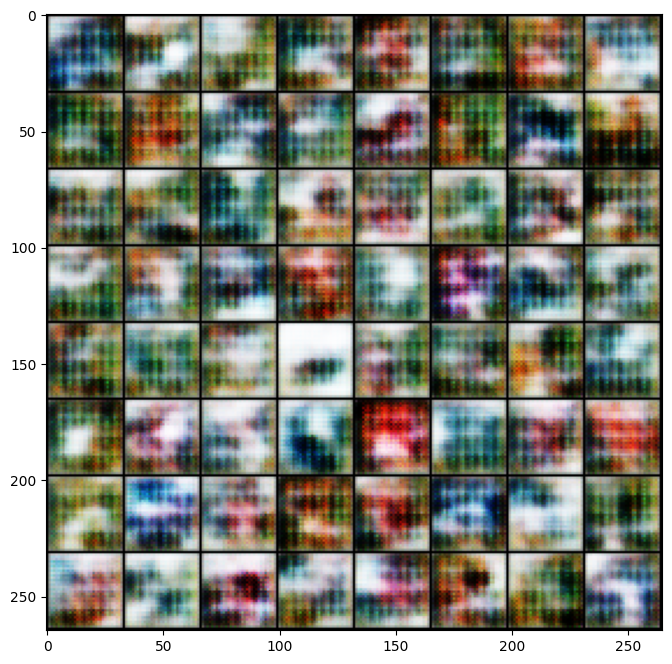

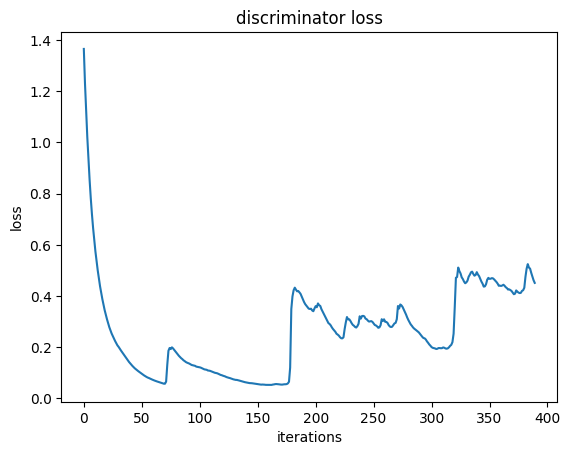

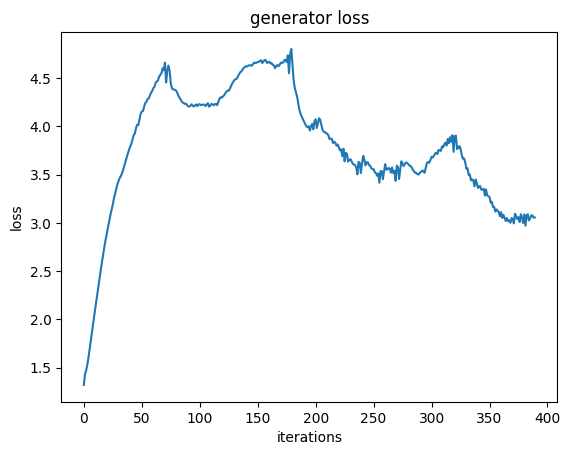

Iteration 400/9750: dis loss = 0.1844, gen loss = 3.7124
Iteration 500/9750: dis loss = 0.6537, gen loss = 1.9258
Iteration 600/9750: dis loss = 0.4327, gen loss = 2.7863
Iteration 700/9750: dis loss = 0.5133, gen loss = 1.9170
Iteration 800/9750: dis loss = 0.6639, gen loss = 2.0245
Iteration 900/9750: dis loss = 0.6507, gen loss = 2.8840
Iteration 1000/9750: dis loss = 0.7360, gen loss = 1.2134
Iteration 1100/9750: dis loss = 0.7373, gen loss = 2.0194


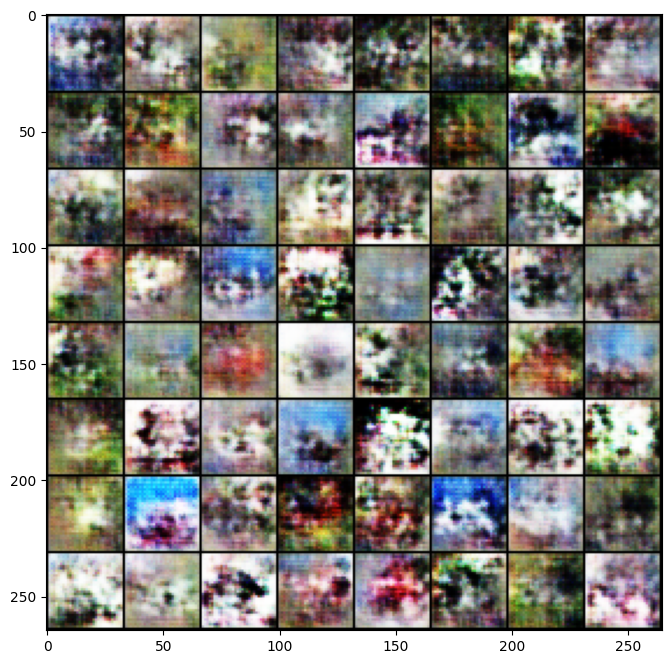

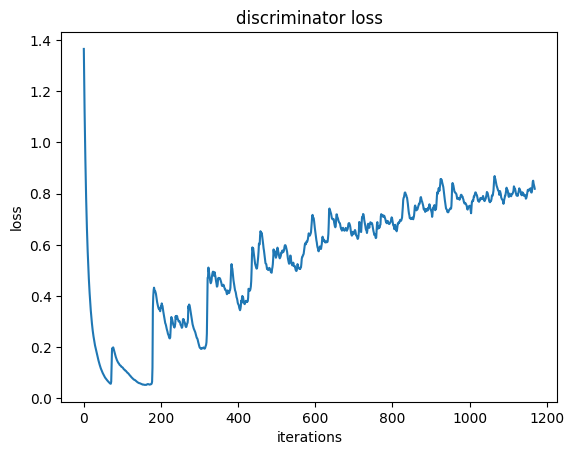

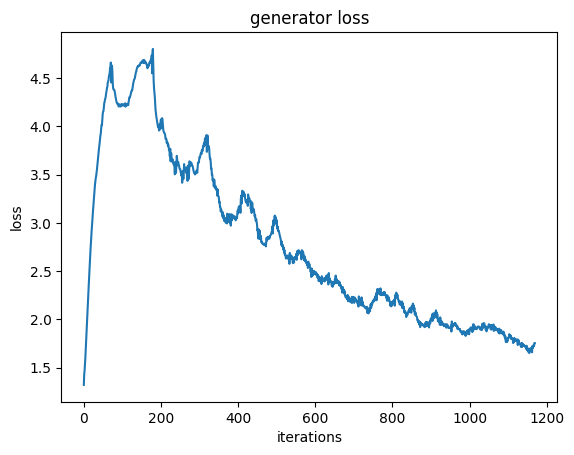

Iteration 1200/9750: dis loss = 0.6921, gen loss = 2.7084
Iteration 1300/9750: dis loss = 0.8180, gen loss = 2.0640
Iteration 1400/9750: dis loss = 0.6377, gen loss = 1.8737
Iteration 1500/9750: dis loss = 0.8405, gen loss = 2.3615
Iteration 1600/9750: dis loss = 0.7018, gen loss = 1.7343
Iteration 1700/9750: dis loss = 0.8622, gen loss = 1.6840
Iteration 1800/9750: dis loss = 0.5218, gen loss = 2.0452
Iteration 1900/9750: dis loss = 0.7609, gen loss = 1.4916


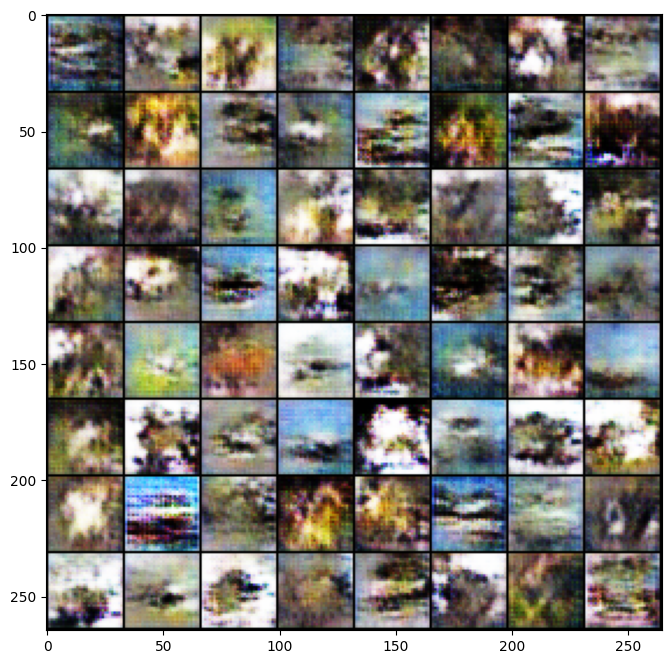

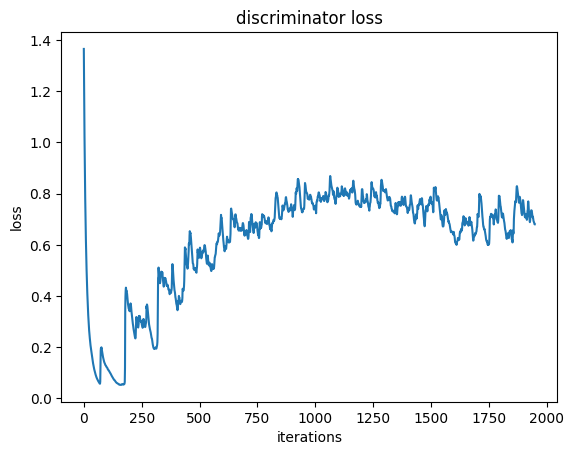

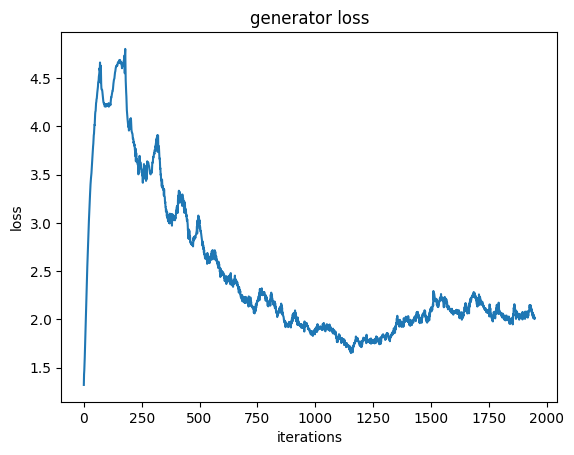

Iteration 2000/9750: dis loss = 0.6977, gen loss = 2.7450
Iteration 2100/9750: dis loss = 0.5724, gen loss = 2.6917
Iteration 2200/9750: dis loss = 0.6860, gen loss = 1.8239
Iteration 2300/9750: dis loss = 0.4874, gen loss = 1.7570
Iteration 2400/9750: dis loss = 0.5706, gen loss = 1.6074
Iteration 2500/9750: dis loss = 0.5640, gen loss = 2.5250
Iteration 2600/9750: dis loss = 0.4204, gen loss = 2.3400
Iteration 2700/9750: dis loss = 0.8916, gen loss = 2.7310


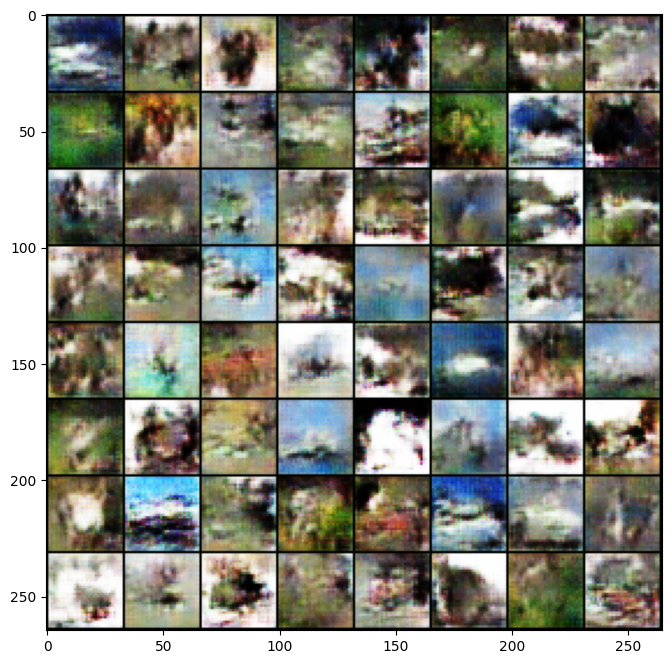

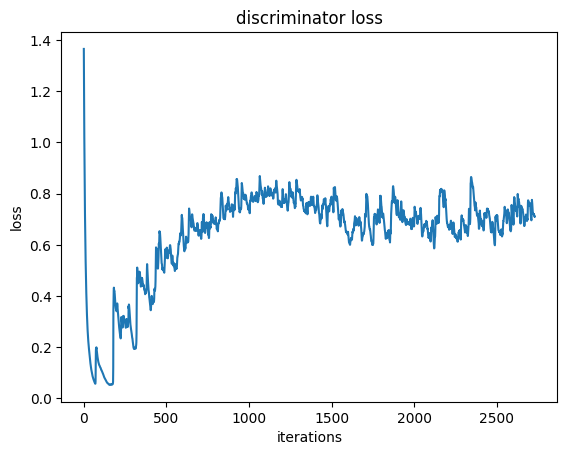

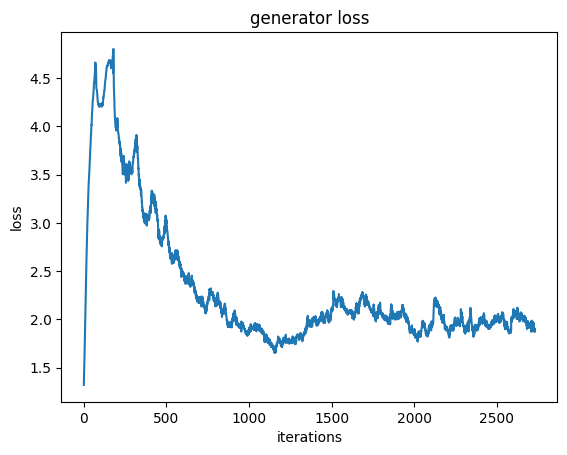

Iteration 2800/9750: dis loss = 0.6051, gen loss = 1.9869
Iteration 2900/9750: dis loss = 0.7602, gen loss = 2.6234
Iteration 3000/9750: dis loss = 0.5101, gen loss = 2.3559
Iteration 3100/9750: dis loss = 0.5703, gen loss = 1.9043
Iteration 3200/9750: dis loss = 0.5520, gen loss = 1.6965
Iteration 3300/9750: dis loss = 1.1951, gen loss = 1.2908
Iteration 3400/9750: dis loss = 1.4407, gen loss = 0.6811
Iteration 3500/9750: dis loss = 0.5909, gen loss = 1.3559


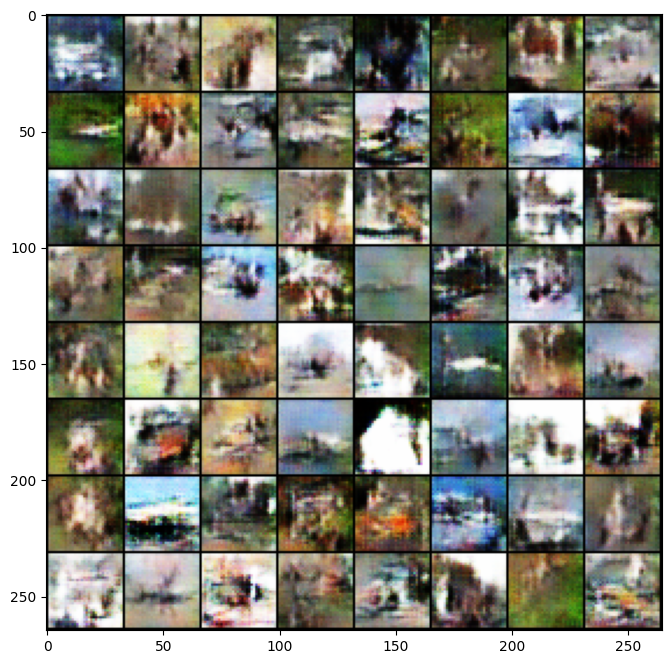

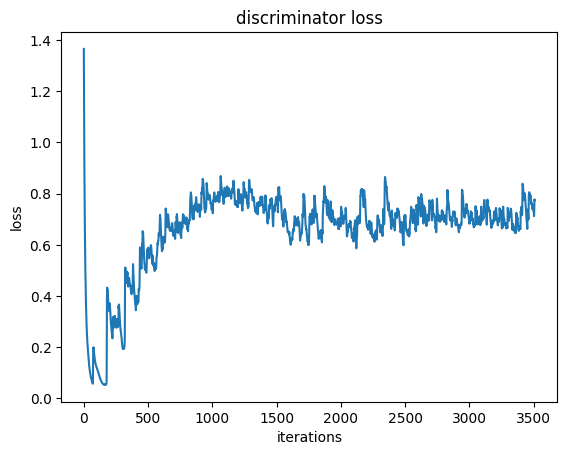

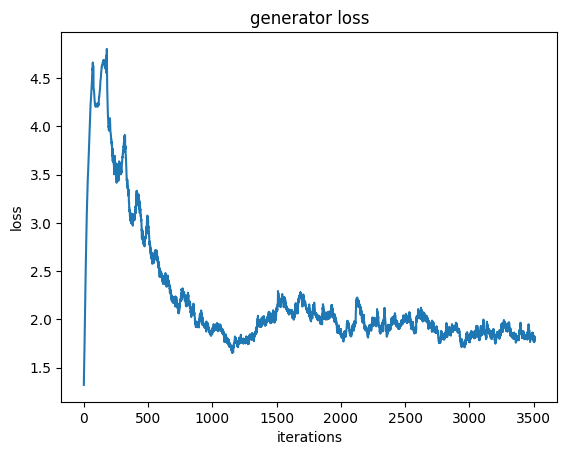

Iteration 3600/9750: dis loss = 0.8202, gen loss = 1.9744
Iteration 3700/9750: dis loss = 0.5554, gen loss = 1.7074
Iteration 3800/9750: dis loss = 0.8988, gen loss = 2.9625
Iteration 3900/9750: dis loss = 0.5778, gen loss = 2.5372
Iteration 4000/9750: dis loss = 0.6958, gen loss = 1.5228
Iteration 4100/9750: dis loss = 0.5984, gen loss = 1.7109
Iteration 4200/9750: dis loss = 0.7138, gen loss = 1.6013


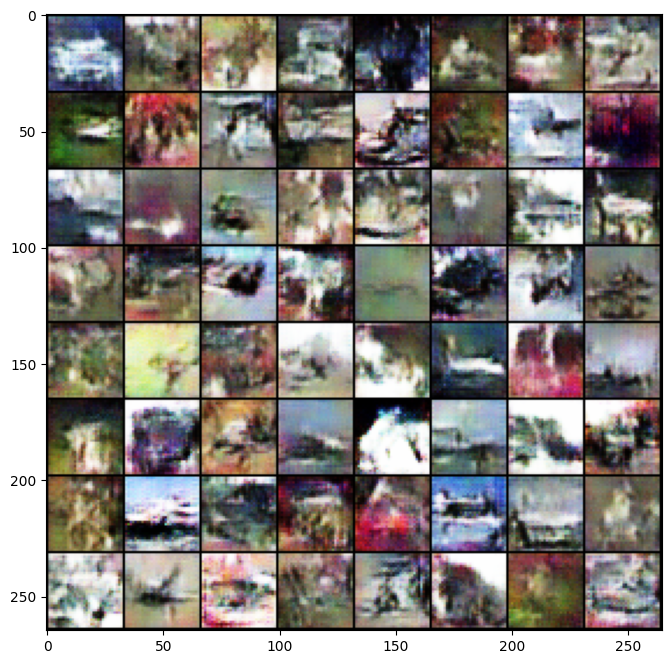

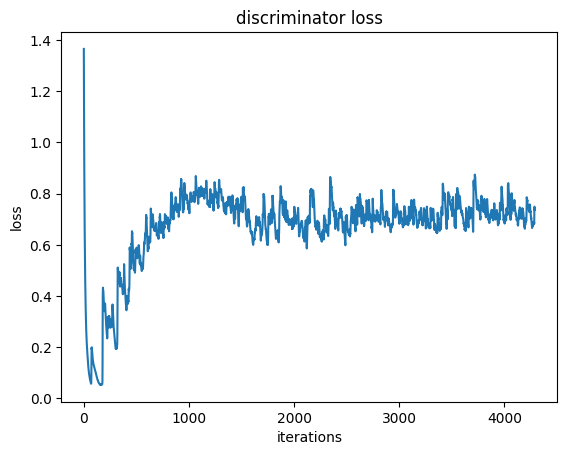

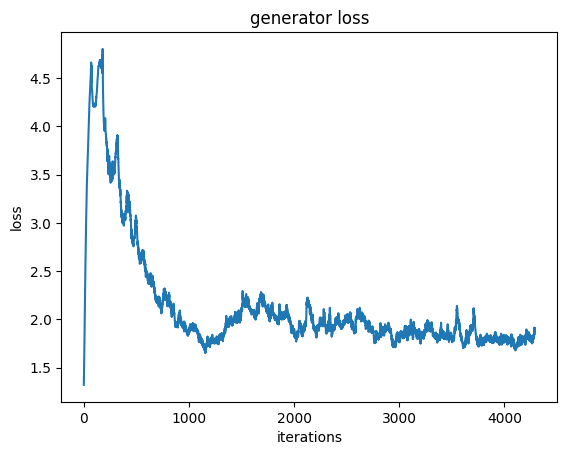

Iteration 4300/9750: dis loss = 0.8981, gen loss = 2.1781
Iteration 4400/9750: dis loss = 0.8365, gen loss = 1.9165
Iteration 4500/9750: dis loss = 0.4651, gen loss = 1.8767
Iteration 4600/9750: dis loss = 0.6573, gen loss = 2.1118
Iteration 4700/9750: dis loss = 0.5363, gen loss = 1.8663
Iteration 4800/9750: dis loss = 0.6326, gen loss = 1.9050
Iteration 4900/9750: dis loss = 0.4830, gen loss = 2.3039
Iteration 5000/9750: dis loss = 0.5387, gen loss = 2.1927


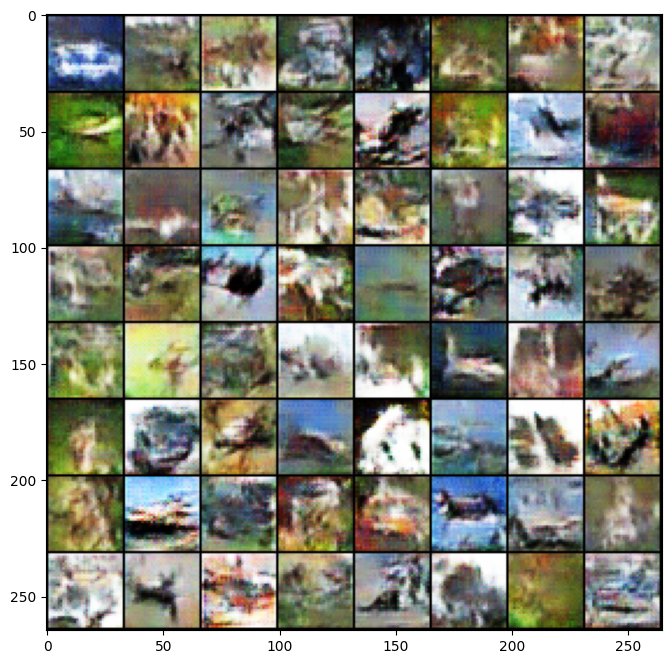

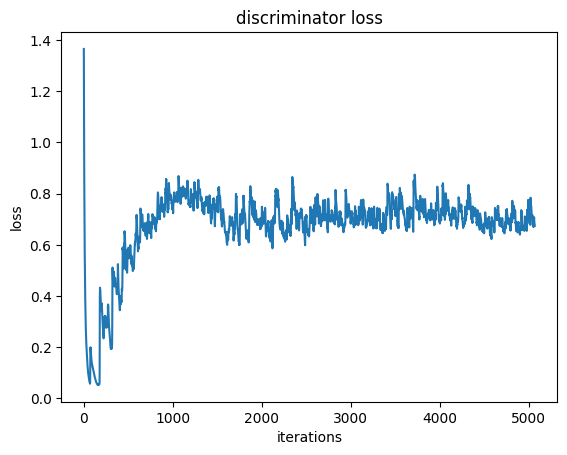

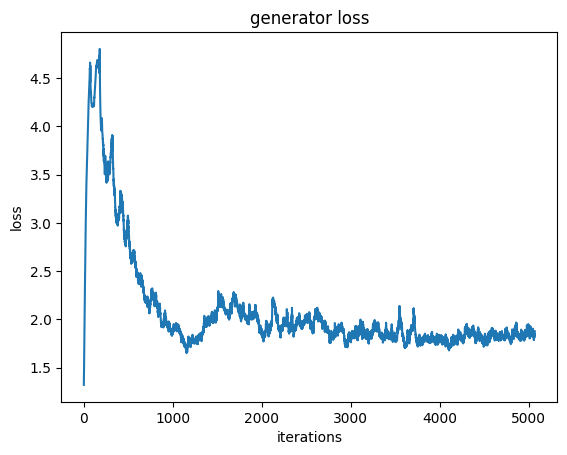

Iteration 5100/9750: dis loss = 0.6146, gen loss = 1.5997
Iteration 5200/9750: dis loss = 0.5164, gen loss = 1.9846
Iteration 5300/9750: dis loss = 0.7478, gen loss = 1.8939
Iteration 5400/9750: dis loss = 0.5174, gen loss = 2.3651
Iteration 5500/9750: dis loss = 1.1467, gen loss = 2.1587
Iteration 5600/9750: dis loss = 0.5430, gen loss = 2.5851
Iteration 5700/9750: dis loss = 0.8083, gen loss = 3.0519
Iteration 5800/9750: dis loss = 0.7574, gen loss = 1.1010


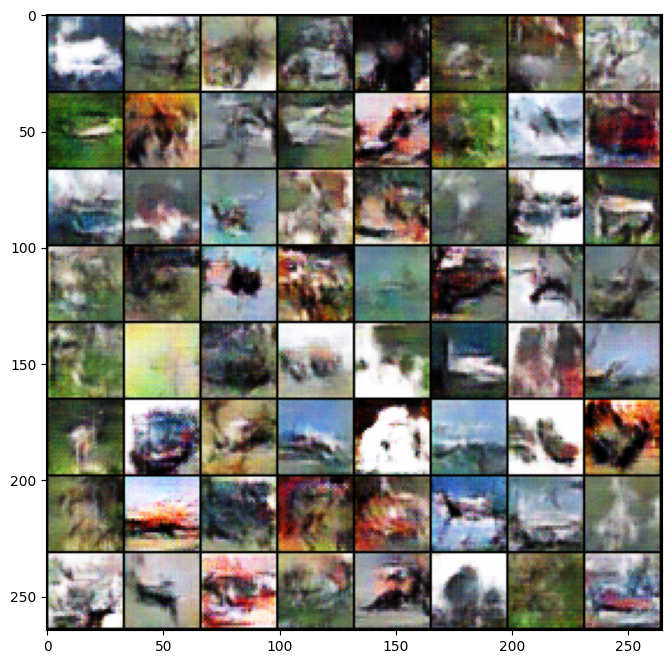

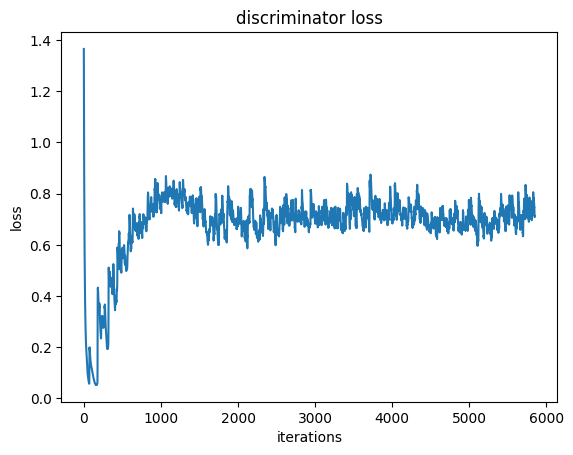

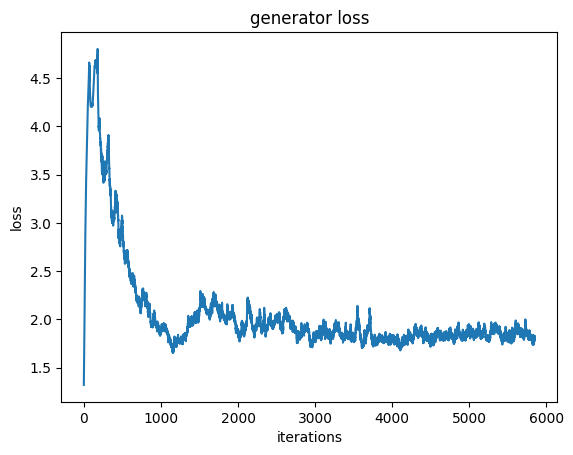

Iteration 5900/9750: dis loss = 0.5753, gen loss = 2.5200
Iteration 6000/9750: dis loss = 0.6548, gen loss = 2.3098
Iteration 6100/9750: dis loss = 0.6188, gen loss = 1.7157
Iteration 6200/9750: dis loss = 0.5762, gen loss = 1.6209
Iteration 6300/9750: dis loss = 0.4882, gen loss = 1.5653
Iteration 6400/9750: dis loss = 1.0508, gen loss = 0.6982
Iteration 6500/9750: dis loss = 0.5876, gen loss = 1.7837
Iteration 6600/9750: dis loss = 0.7275, gen loss = 1.6924


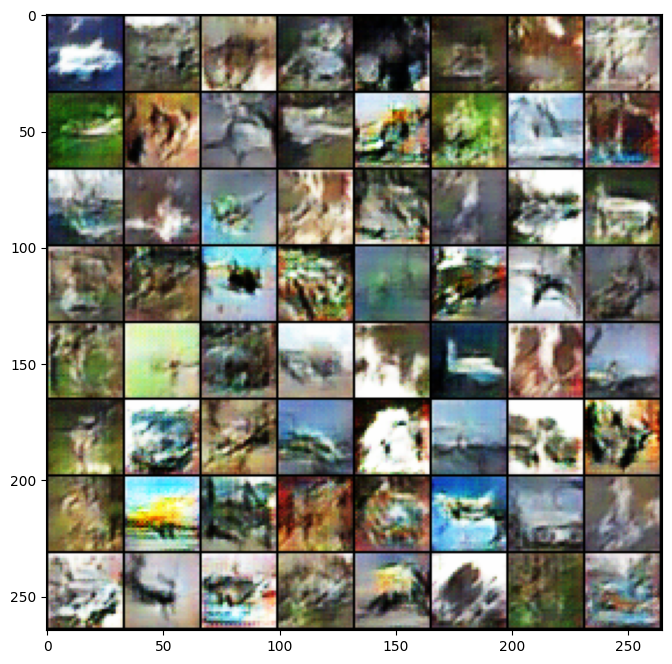

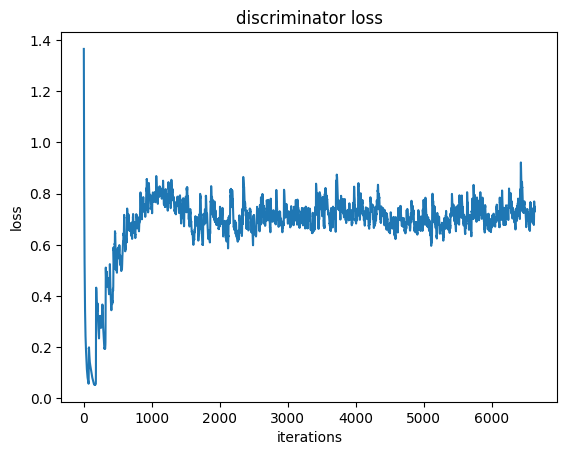

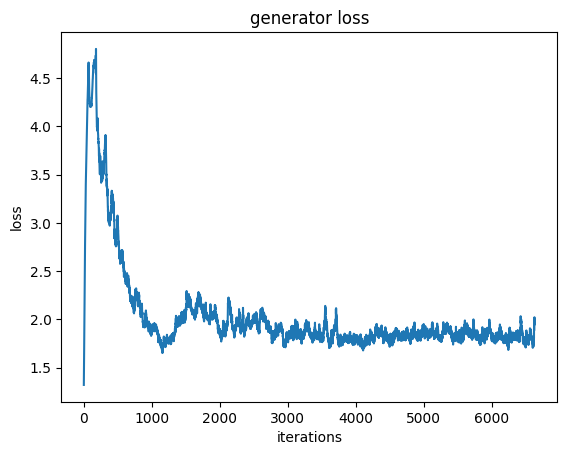

Iteration 6700/9750: dis loss = 0.8701, gen loss = 0.6012
Iteration 6800/9750: dis loss = 0.6506, gen loss = 1.5157
Iteration 6900/9750: dis loss = 0.7280, gen loss = 1.5760
Iteration 7000/9750: dis loss = 0.4008, gen loss = 1.9708
Iteration 7100/9750: dis loss = 0.6365, gen loss = 1.6965
Iteration 7200/9750: dis loss = 0.7563, gen loss = 1.7290
Iteration 7300/9750: dis loss = 0.4629, gen loss = 2.2343
Iteration 7400/9750: dis loss = 0.4750, gen loss = 3.3000


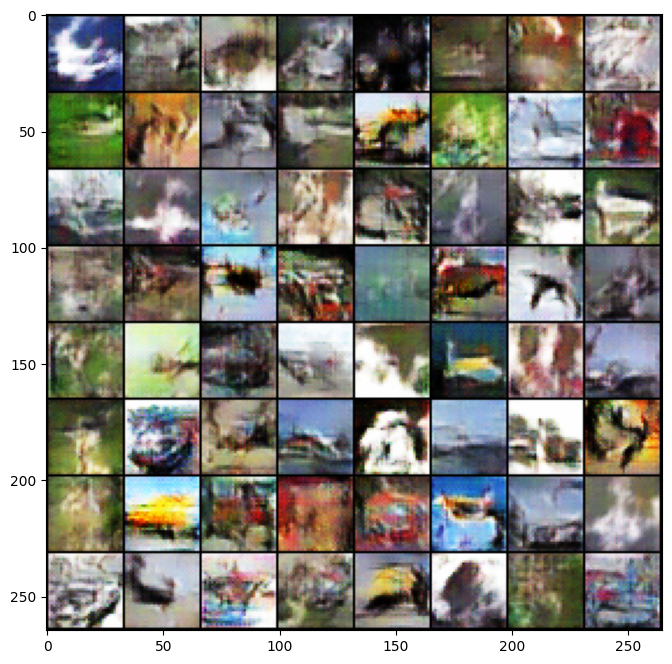

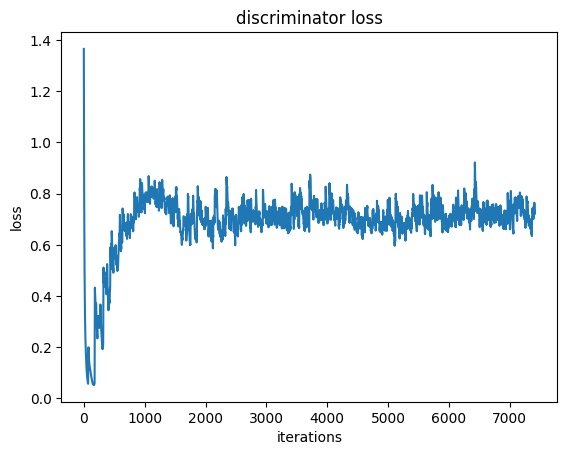

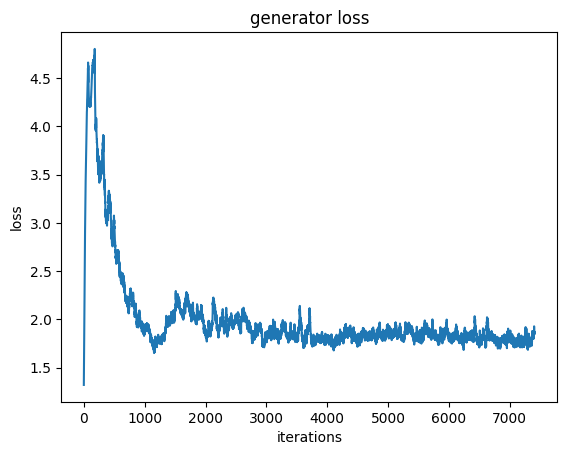

Iteration 7500/9750: dis loss = 0.8813, gen loss = 3.3294
Iteration 7600/9750: dis loss = 0.5846, gen loss = 1.0597
Iteration 7700/9750: dis loss = 0.6577, gen loss = 2.6740
Iteration 7800/9750: dis loss = 0.7025, gen loss = 2.1075
Iteration 7900/9750: dis loss = 1.0338, gen loss = 0.9107
Iteration 8000/9750: dis loss = 0.5398, gen loss = 1.3557
Iteration 8100/9750: dis loss = 0.5607, gen loss = 1.7854


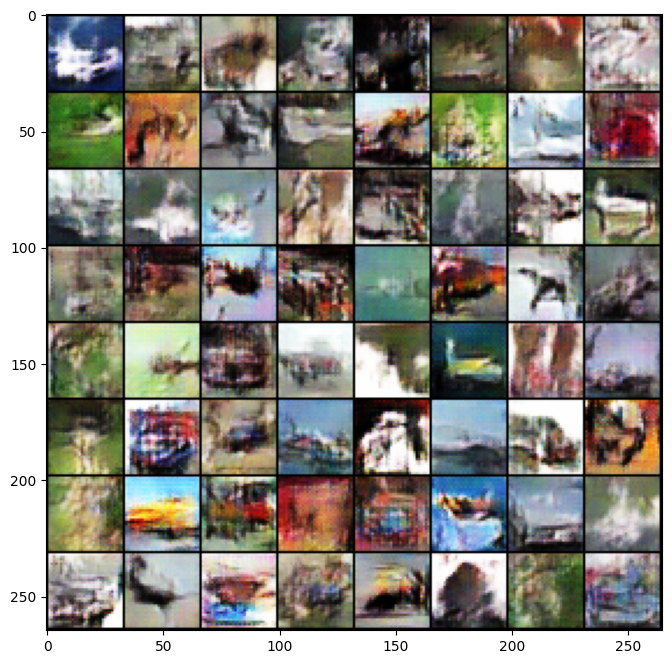

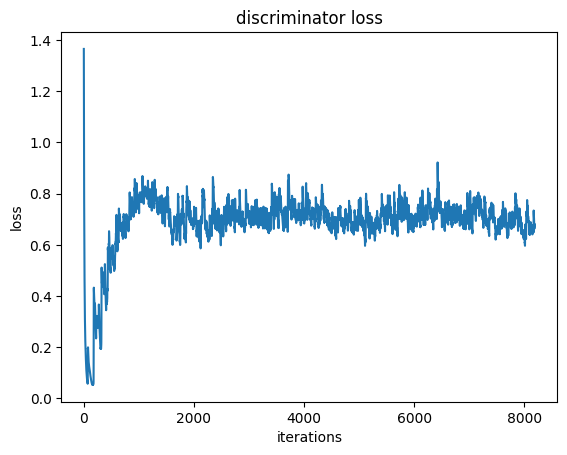

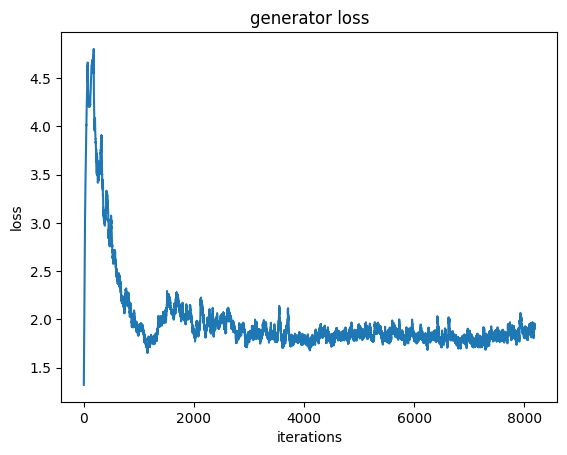

Iteration 8200/9750: dis loss = 1.3608, gen loss = 1.0645
Iteration 8300/9750: dis loss = 0.4287, gen loss = 2.2036
Iteration 8400/9750: dis loss = 0.7046, gen loss = 1.8410
Iteration 8500/9750: dis loss = 0.6059, gen loss = 1.7357
Iteration 8600/9750: dis loss = 0.7497, gen loss = 2.0636
Iteration 8700/9750: dis loss = 0.6839, gen loss = 2.0377
Iteration 8800/9750: dis loss = 0.7475, gen loss = 1.2321
Iteration 8900/9750: dis loss = 0.7287, gen loss = 2.1436


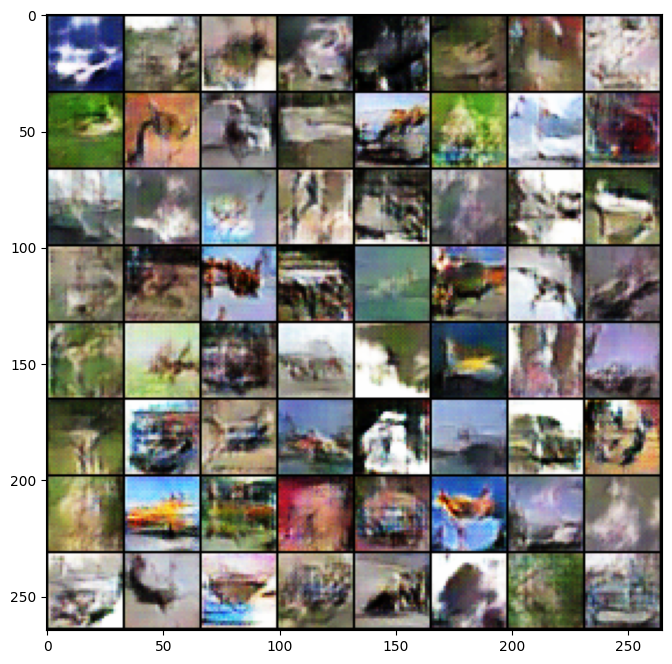

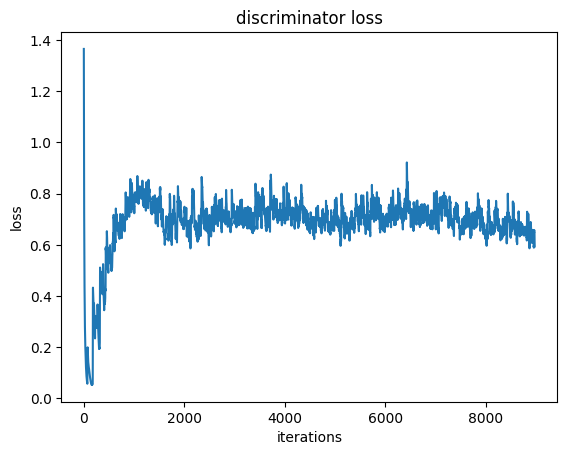

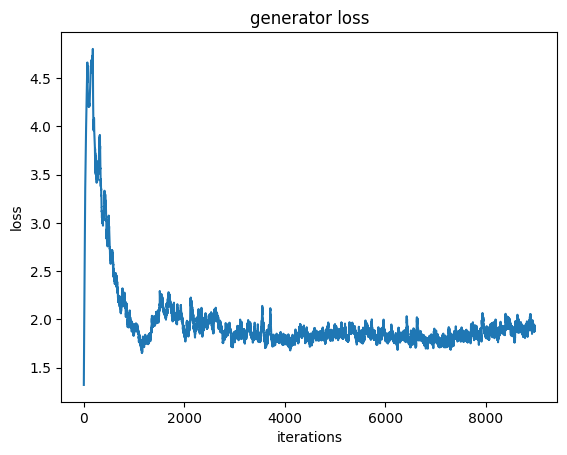

Iteration 9000/9750: dis loss = 0.6397, gen loss = 1.7612
Iteration 9100/9750: dis loss = 0.6504, gen loss = 1.5847
Iteration 9200/9750: dis loss = 0.8848, gen loss = 2.7787
Iteration 9300/9750: dis loss = 0.7450, gen loss = 1.7798
Iteration 9400/9750: dis loss = 0.8974, gen loss = 4.6465
Iteration 9500/9750: dis loss = 0.5966, gen loss = 1.8724
Iteration 9600/9750: dis loss = 0.4574, gen loss = 1.3387
Iteration 9700/9750: dis loss = 0.6821, gen loss = 1.7634


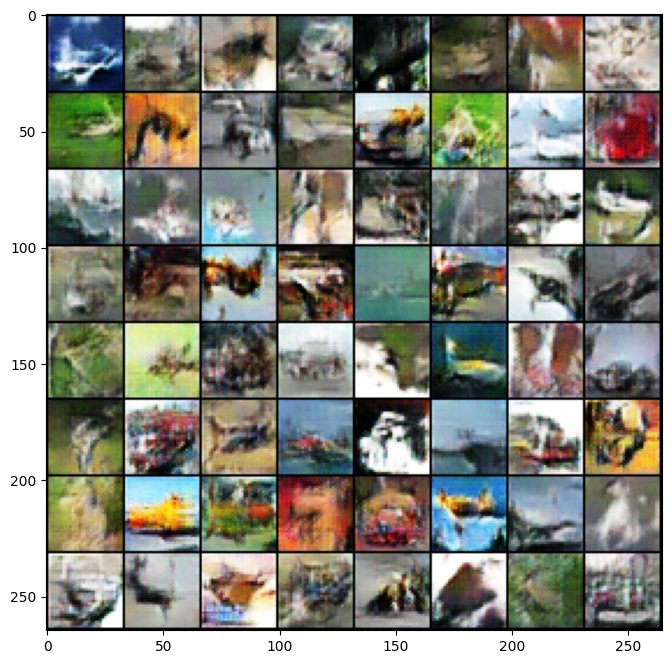

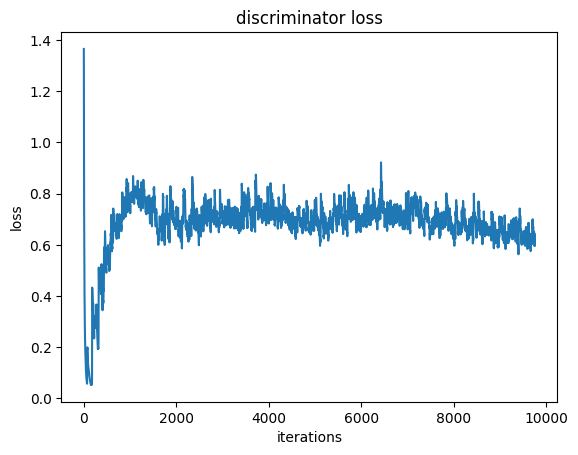

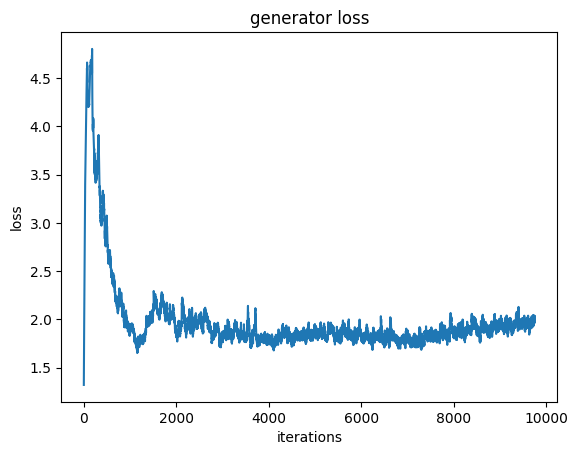

... Done!


In [7]:
set_seed(42)

dcgan = DCGAN()
dcgan.train(train_samples)
torch.save(dcgan.state_dict(), "dcgan.pt")

# **Problem 2-2: The Batch Normalization dilemma (4 pts)**

Here are two questions related to the use of Batch Normalization in GANs. Q1 below will not be graded and the answer is provided. But you should attempt to solve it before looking at the answer. 

##**Q2 will be graded.**

---

***Q1:*** We made separate batches for real samples and fake samples when training the discriminator. Is this just an arbitrary design decision made by the inventor that later becomes the common practice, or is it critical to the correctness of the algorithm? **[0 pt]**

**Answer to Q1:** When we are training the generator, the input batch to the discriminator will always consist of only fake samples. If we separate real and fake batches when training the discriminator, then the fake samples are normalized in the same way when we are training the discriminator and when we are training the generator. If we mix real and fake samples in the same batch when training the discriminator, then the fake samples are not normalized in the same way when we train the two networks, which causes the generator to fail to learn the correct distribution.

***Q2:*** Look at the construction of the discriminator carefully. You will find that between dis_conv1 and dis_lrelu1 there is no batch normalization. This is not a mistake. What could go wrong if there were a batch normalization layer there? Why do you think that omitting this batch normalization layer solves the problem practically if not theoretically? **[3 pt]**

**Please provide your answer to Q2:** <br>
Batch normalization can shift the distribution of the feature maps away from the manifold thus leading to a over regularization and can cause the discriminator to overfit to the training set, making it less effective at detecting fake samples that differ significantly from the training set.
By omitting batch normalization in this specific layer, the discriminator is forced to rely more on the learned features from the raw input data rather than the normalization of the data. This can help the discriminator generalize better to new, unseen samples and improve the overall performance of the GAN.
Additionally, batch normaliztion may slow down the training process and cause instability,  especially when dealing with high-dimensional data or complex network architectures.



---

Takeaway from this problem: **always excercise extreme caution when using batch normalization in your network!**

For further info (optional): you can read this paper to find out more about why Batch Normalization might be bad for your GANs: [On the Effects of Batch and Weight Normalization in Generative Adversarial Networks](https://urldefense.com/v3/__https://arxiv.org/abs/1704.03971__;!!LIr3w8kk_Xxm!_OyEq6RR8H2WeaK3_oOAGVDF3QgpTm6kRTMtpMyD8QNo1-3RJzf5a8EMoSoPDg$)

---


# **Problem 2-3: What about other normalization methods for GAN? (4 pts)**

[Spectral norm](https://arxiv.org/pdf/1802.05957.pdf) is a way of stabilizing the GAN training of discriminator. Please add the embedded spectral norm function in Pytorch to the Discriminator class below in order to test its effects. (see link: https://pytorch.org/docs/stable/generated/torch.nn.utils.spectral_norm.html)

In [8]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        ################################################################################
        # Prob 2-3:                                                                    #
        # adding spectral norm to the discriminator                                    #
        ################################################################################
        self.downsample = nn.Sequential(
            nn.utils.spectral_norm(nn.Conv2d(in_channels=3, out_channels=32, kernel_size=4, stride=2, padding=1, bias=True)),
            nn.LeakyReLU(),
            nn.utils.spectral_norm(nn.Conv2d(in_channels=32, out_channels=64, kernel_size=4, stride=2, padding=1, bias=True)),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(),
            nn.utils.spectral_norm(nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=True)),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(),
        )
        ################################################################################
        # END OF YOUR CODE                                                             #
        ################################################################################
        self.fc = nn.Linear(4 * 4 * 128, 1)
    def forward(self, input):
        downsampled_image = self.downsample(input)
        reshaped_for_fc = downsampled_image.reshape((-1, 4 * 4 * 128))
        classification_probs = self.fc(reshaped_for_fc)
        return classification_probs

**After adding the spectral norm to the discriminator, redo the training block below to see the effects.**

Start training ...
Iteration 100/9750: dis loss = 0.0648, gen loss = 4.6805
Iteration 200/9750: dis loss = 0.1633, gen loss = 4.1657
Iteration 300/9750: dis loss = 0.1197, gen loss = 5.0226


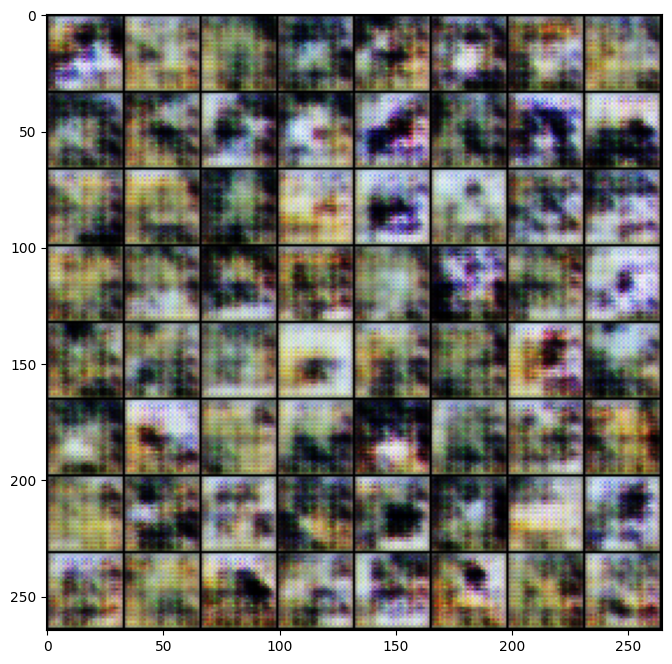

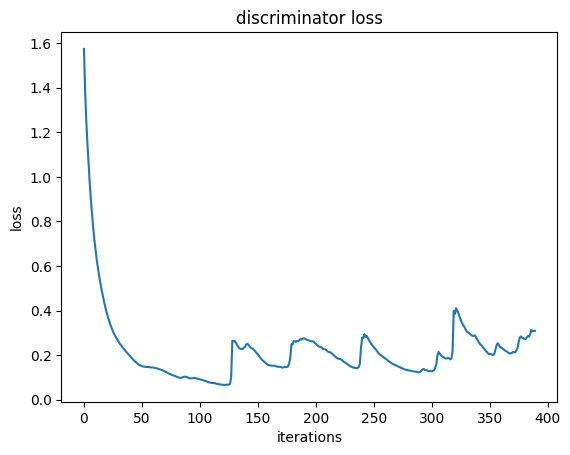

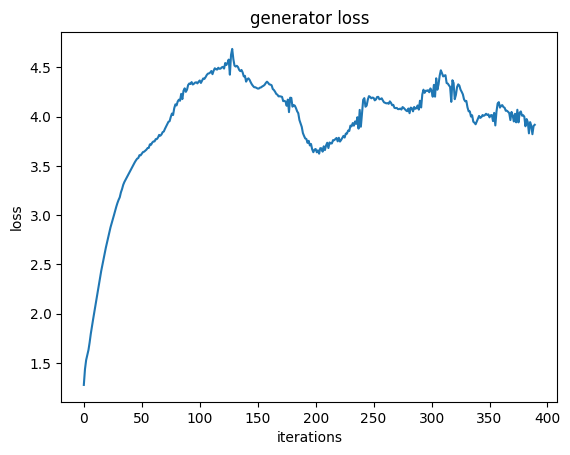

Iteration 400/9750: dis loss = 0.3029, gen loss = 5.3483
Iteration 500/9750: dis loss = 0.3551, gen loss = 2.8380
Iteration 600/9750: dis loss = 0.5872, gen loss = 1.5646
Iteration 700/9750: dis loss = 0.5901, gen loss = 2.5002
Iteration 800/9750: dis loss = 0.7450, gen loss = 1.8279
Iteration 900/9750: dis loss = 0.7659, gen loss = 2.1727
Iteration 1000/9750: dis loss = 0.7462, gen loss = 2.1157
Iteration 1100/9750: dis loss = 0.8217, gen loss = 1.6846


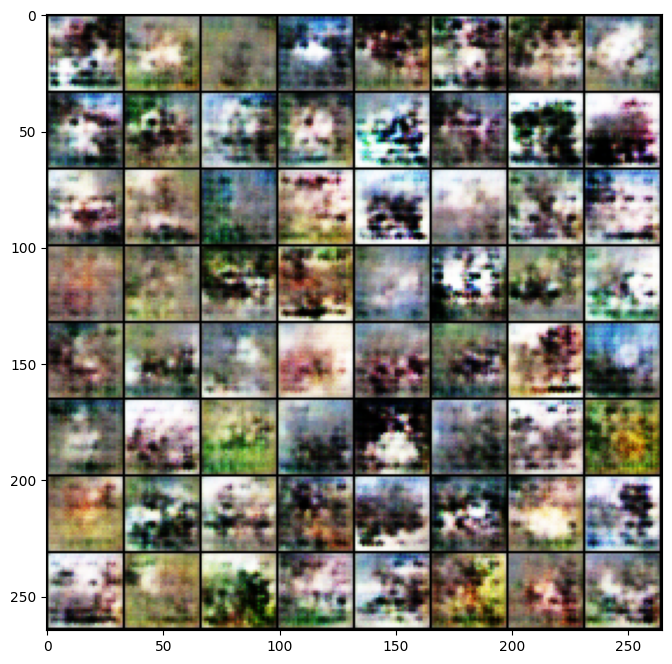

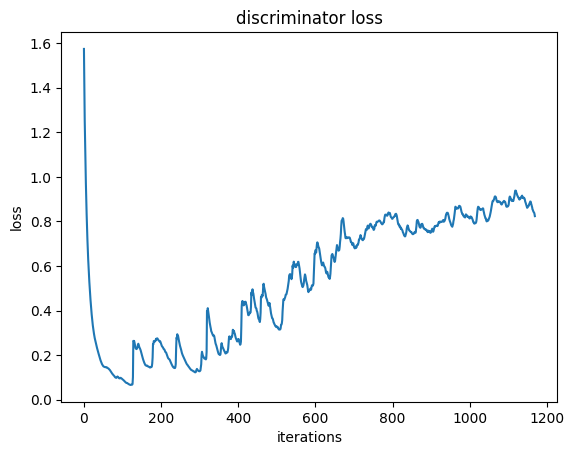

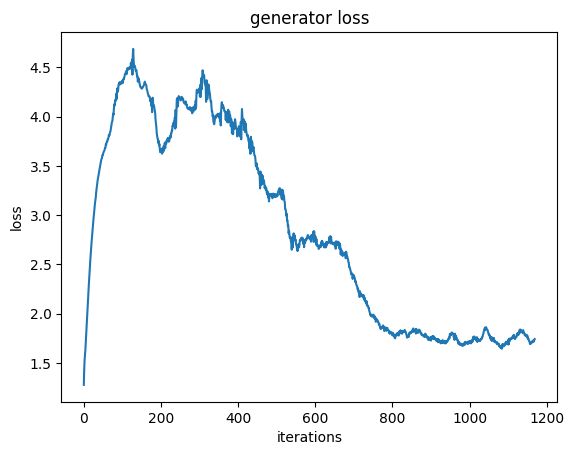

Iteration 1200/9750: dis loss = 0.6235, gen loss = 1.9400
Iteration 1300/9750: dis loss = 0.9409, gen loss = 2.2478
Iteration 1400/9750: dis loss = 0.6941, gen loss = 1.4591
Iteration 1500/9750: dis loss = 0.6469, gen loss = 1.4398
Iteration 1600/9750: dis loss = 0.6388, gen loss = 2.0971
Iteration 1700/9750: dis loss = 0.5129, gen loss = 1.5888
Iteration 1800/9750: dis loss = 0.5713, gen loss = 2.0255
Iteration 1900/9750: dis loss = 0.6654, gen loss = 1.4380


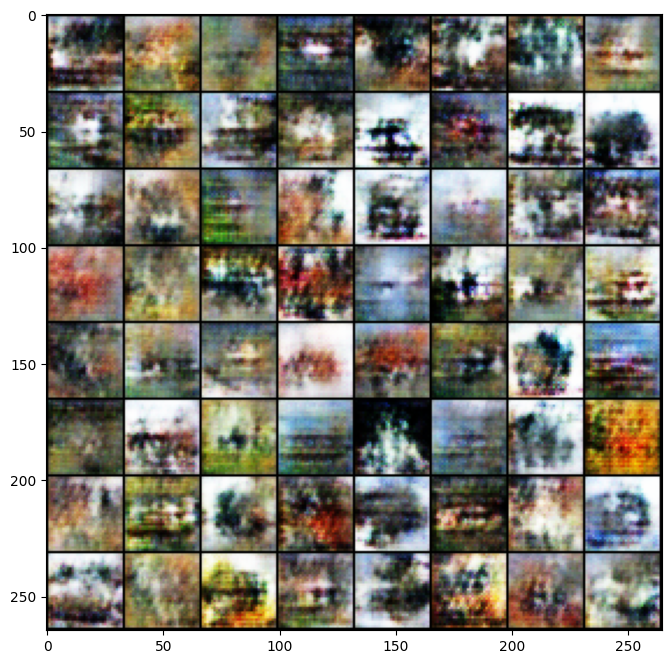

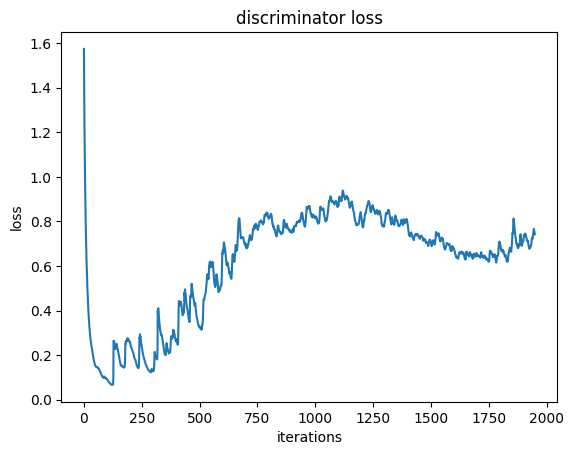

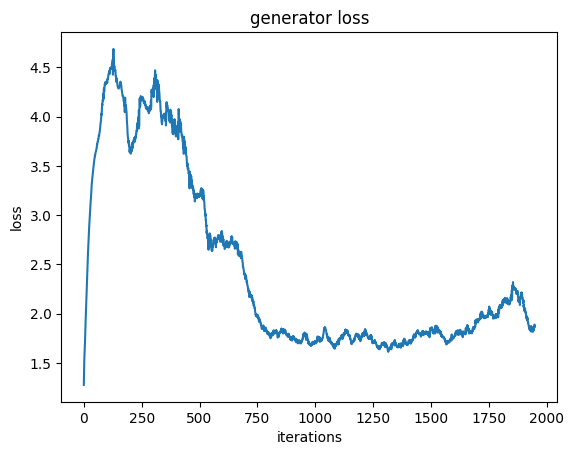

Iteration 2000/9750: dis loss = 0.7617, gen loss = 1.9795
Iteration 2100/9750: dis loss = 0.7533, gen loss = 1.2211
Iteration 2200/9750: dis loss = 1.3818, gen loss = 2.4223
Iteration 2300/9750: dis loss = 0.7057, gen loss = 1.6701
Iteration 2400/9750: dis loss = 0.6837, gen loss = 2.0038
Iteration 2500/9750: dis loss = 0.6711, gen loss = 1.7061
Iteration 2600/9750: dis loss = 0.7549, gen loss = 1.3800
Iteration 2700/9750: dis loss = 0.6659, gen loss = 2.4391


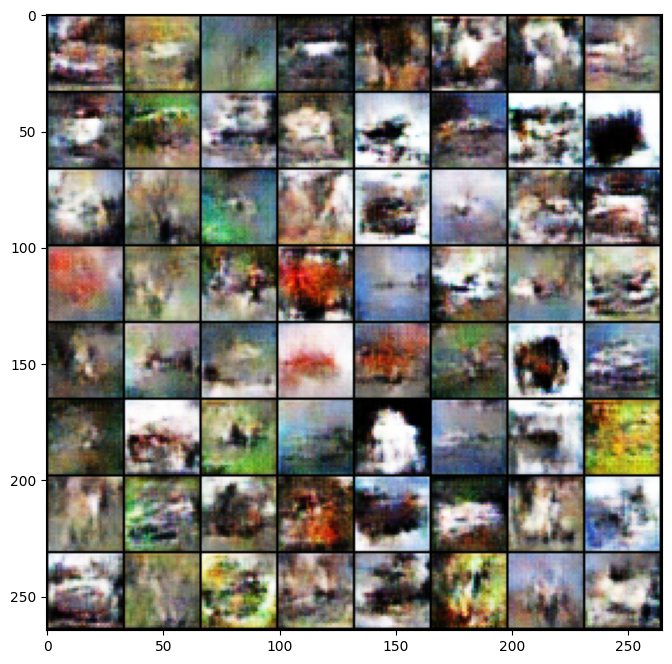

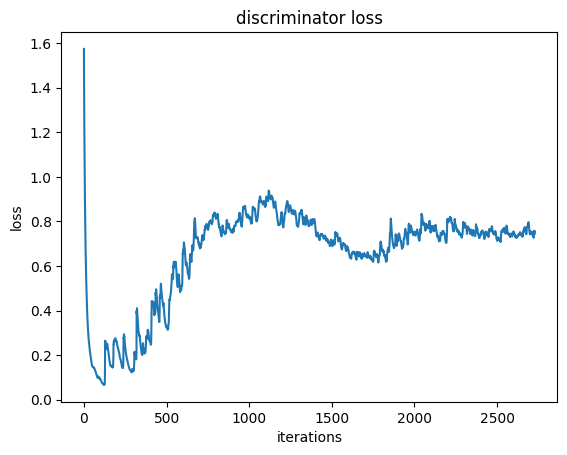

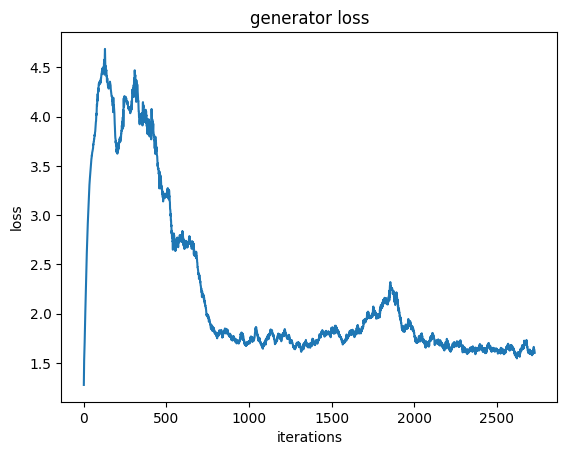

Iteration 2800/9750: dis loss = 0.6650, gen loss = 1.3542
Iteration 2900/9750: dis loss = 0.5604, gen loss = 2.0605
Iteration 3000/9750: dis loss = 1.0133, gen loss = 0.8731
Iteration 3100/9750: dis loss = 0.7058, gen loss = 1.9364
Iteration 3200/9750: dis loss = 0.7584, gen loss = 1.8747
Iteration 3300/9750: dis loss = 0.8638, gen loss = 2.0815
Iteration 3400/9750: dis loss = 0.7017, gen loss = 1.8291
Iteration 3500/9750: dis loss = 0.7104, gen loss = 2.3654


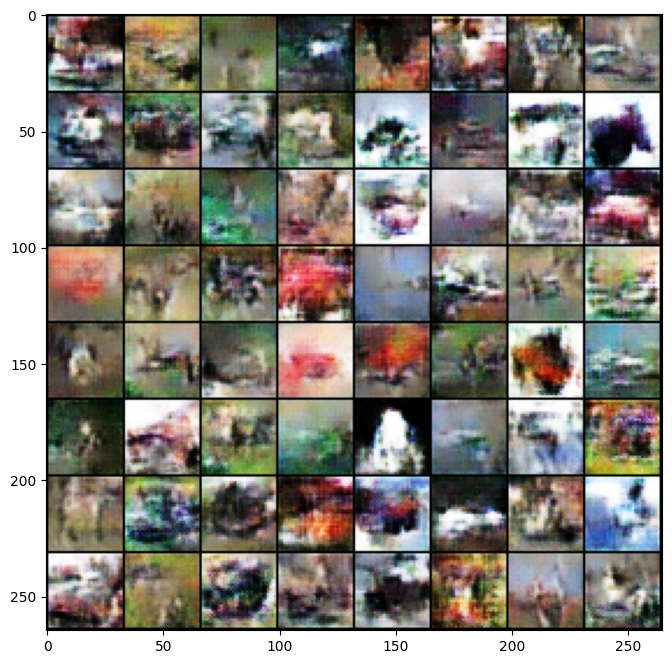

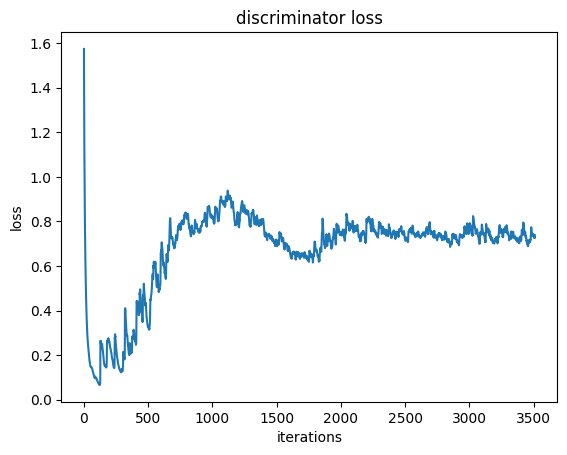

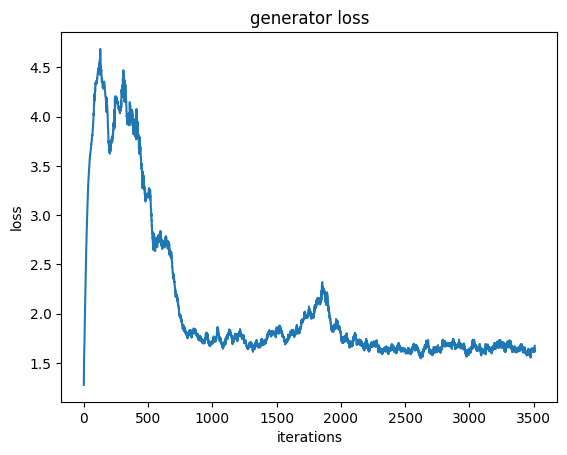

Iteration 3600/9750: dis loss = 0.7281, gen loss = 1.6871
Iteration 3700/9750: dis loss = 0.8213, gen loss = 2.5933
Iteration 3800/9750: dis loss = 0.8458, gen loss = 1.0260
Iteration 3900/9750: dis loss = 0.6602, gen loss = 1.5587
Iteration 4000/9750: dis loss = 0.5632, gen loss = 1.6958
Iteration 4100/9750: dis loss = 0.8192, gen loss = 2.8690
Iteration 4200/9750: dis loss = 0.7637, gen loss = 1.2620


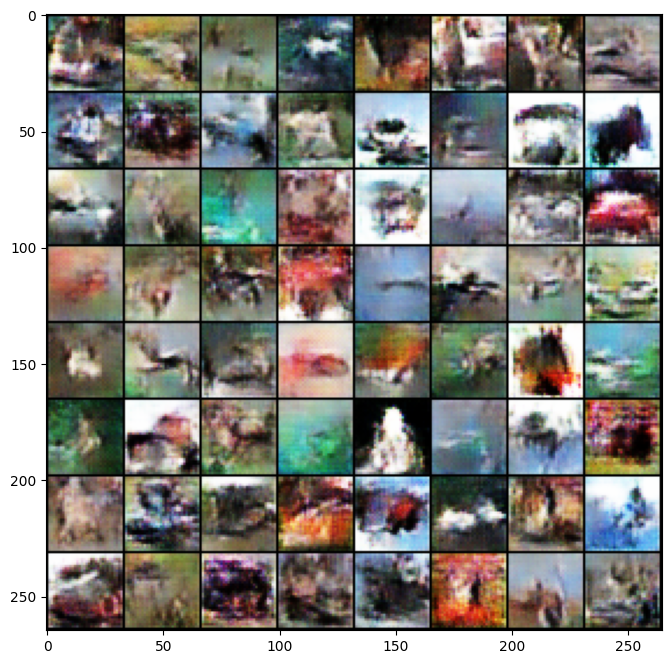

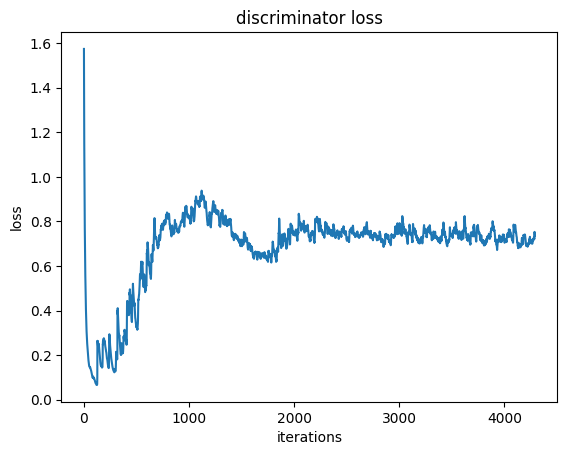

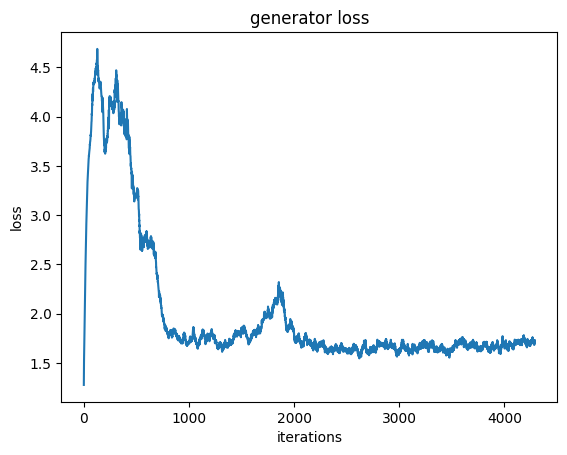

Iteration 4300/9750: dis loss = 0.7024, gen loss = 1.4126
Iteration 4400/9750: dis loss = 0.7200, gen loss = 2.2585
Iteration 4500/9750: dis loss = 1.0903, gen loss = 2.4584
Iteration 4600/9750: dis loss = 0.6441, gen loss = 1.4376
Iteration 4700/9750: dis loss = 0.7636, gen loss = 1.4891
Iteration 4800/9750: dis loss = 0.6630, gen loss = 1.1749
Iteration 4900/9750: dis loss = 0.6632, gen loss = 1.6123
Iteration 5000/9750: dis loss = 0.7169, gen loss = 1.6513


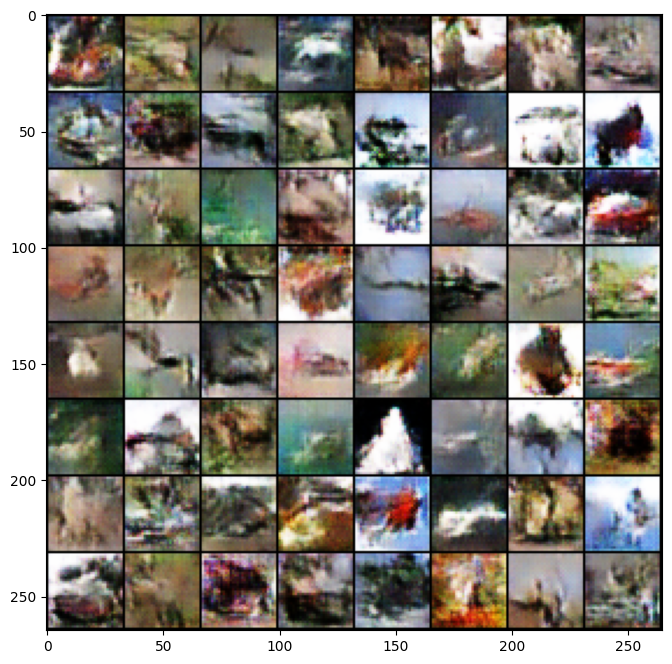

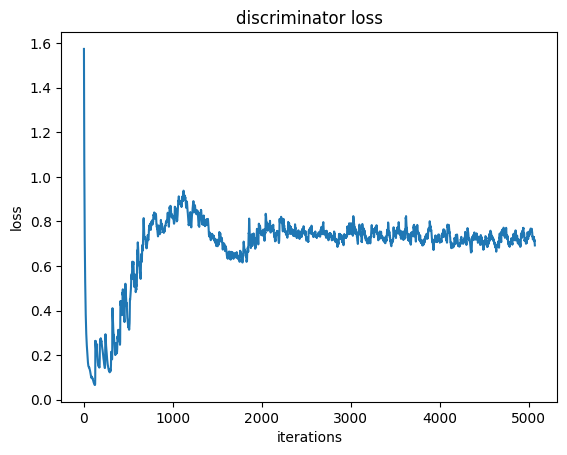

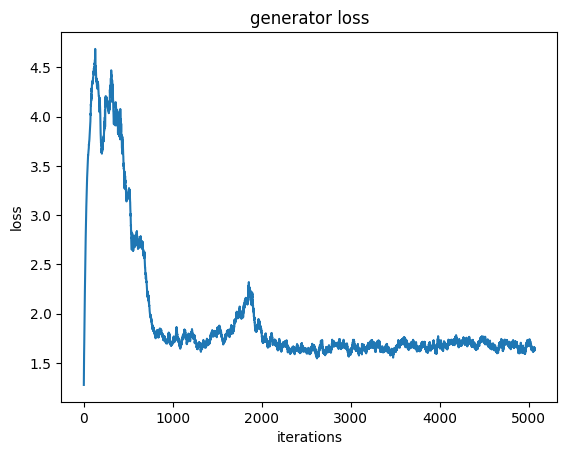

Iteration 5100/9750: dis loss = 0.8192, gen loss = 1.2783
Iteration 5200/9750: dis loss = 1.2206, gen loss = 2.6707
Iteration 5300/9750: dis loss = 0.6584, gen loss = 1.7395
Iteration 5400/9750: dis loss = 0.7101, gen loss = 0.9323
Iteration 5500/9750: dis loss = 0.6386, gen loss = 1.5694
Iteration 5600/9750: dis loss = 0.8026, gen loss = 1.9697
Iteration 5700/9750: dis loss = 0.7024, gen loss = 1.8918
Iteration 5800/9750: dis loss = 0.7074, gen loss = 1.2338


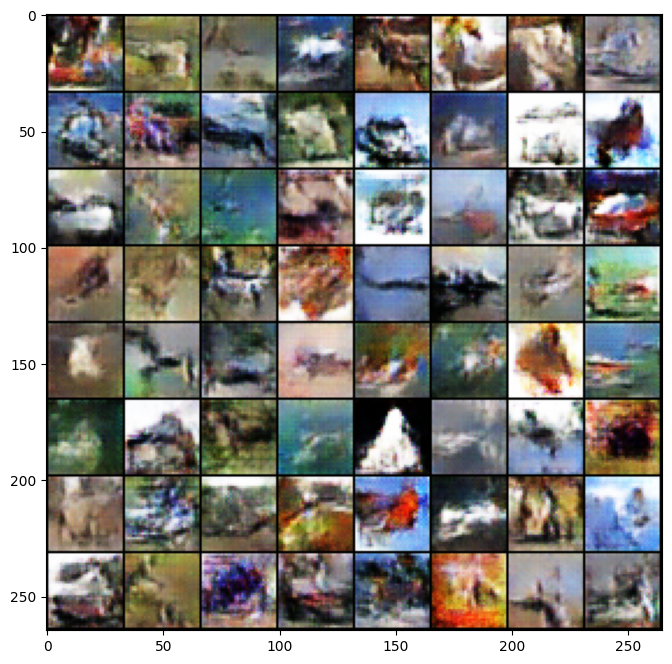

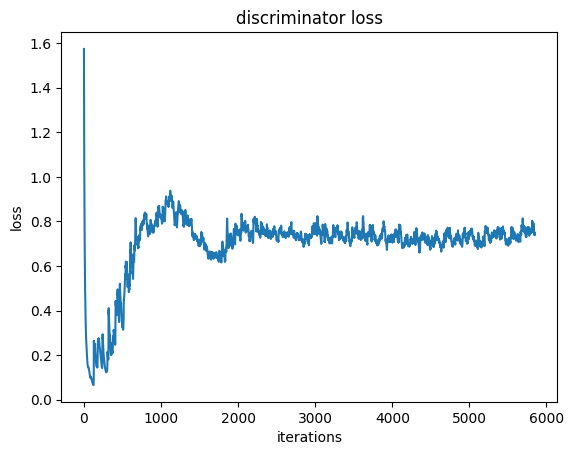

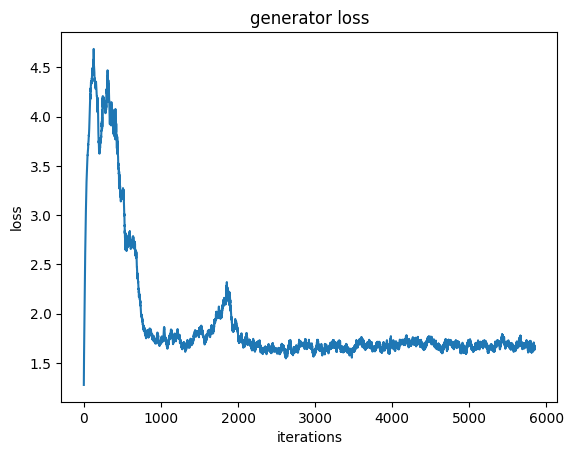

Iteration 5900/9750: dis loss = 0.7102, gen loss = 2.1828
Iteration 6000/9750: dis loss = 0.6319, gen loss = 1.8169
Iteration 6100/9750: dis loss = 0.6833, gen loss = 1.6740
Iteration 6200/9750: dis loss = 0.7141, gen loss = 1.7295
Iteration 6300/9750: dis loss = 0.8160, gen loss = 2.3734
Iteration 6400/9750: dis loss = 0.6637, gen loss = 1.9686
Iteration 6500/9750: dis loss = 0.7348, gen loss = 2.4972
Iteration 6600/9750: dis loss = 0.9674, gen loss = 1.0071


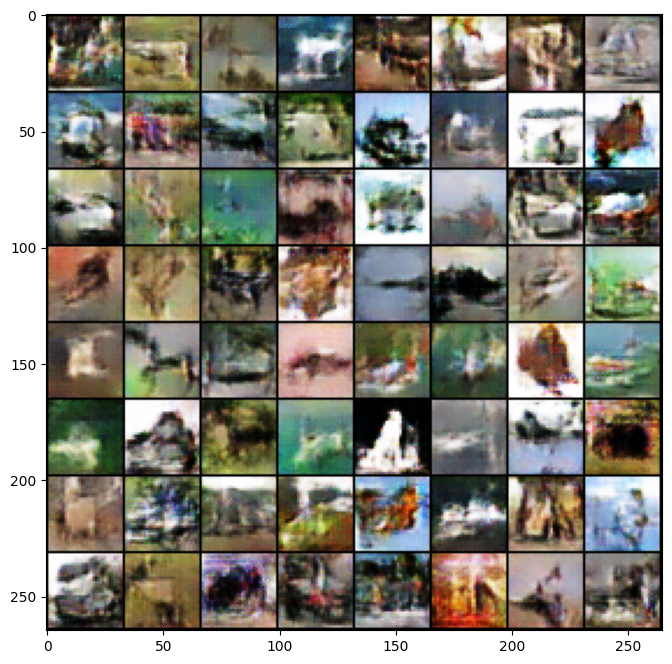

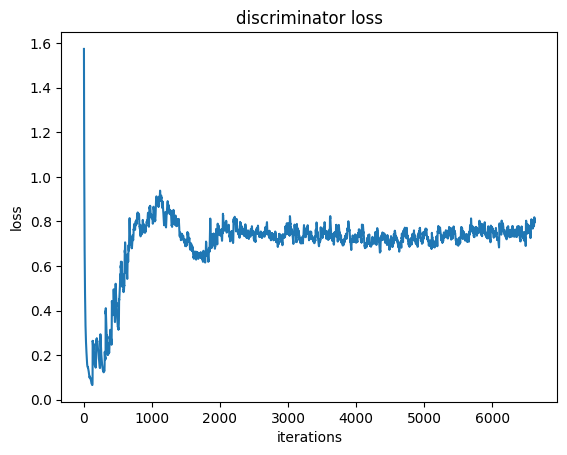

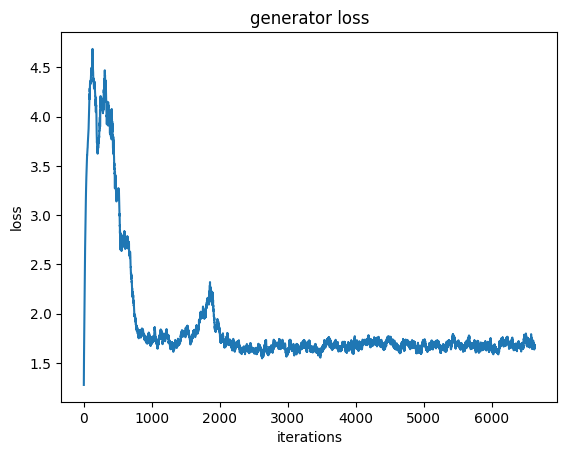

Iteration 6700/9750: dis loss = 0.7461, gen loss = 1.3262
Iteration 6800/9750: dis loss = 0.7412, gen loss = 1.9579
Iteration 6900/9750: dis loss = 0.6084, gen loss = 2.0424
Iteration 7000/9750: dis loss = 0.7449, gen loss = 1.3070
Iteration 7100/9750: dis loss = 0.6558, gen loss = 2.3004
Iteration 7200/9750: dis loss = 0.6214, gen loss = 1.4895
Iteration 7300/9750: dis loss = 0.8197, gen loss = 1.9302
Iteration 7400/9750: dis loss = 0.6719, gen loss = 2.2517


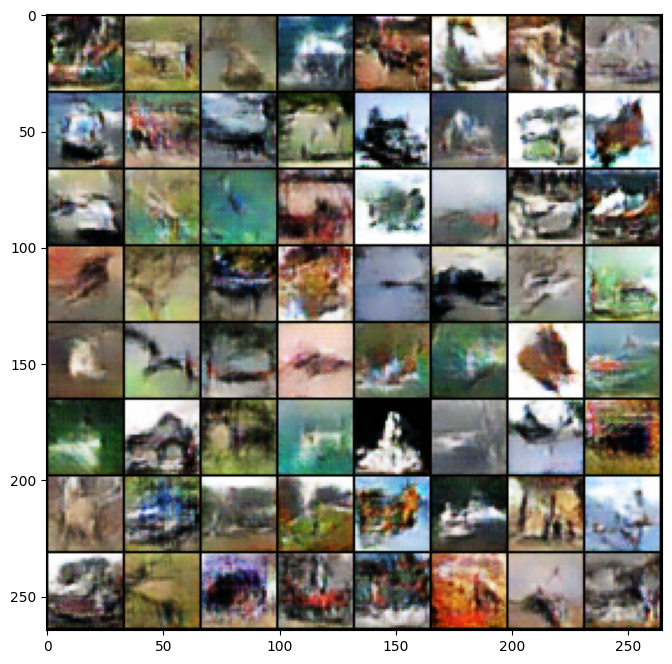

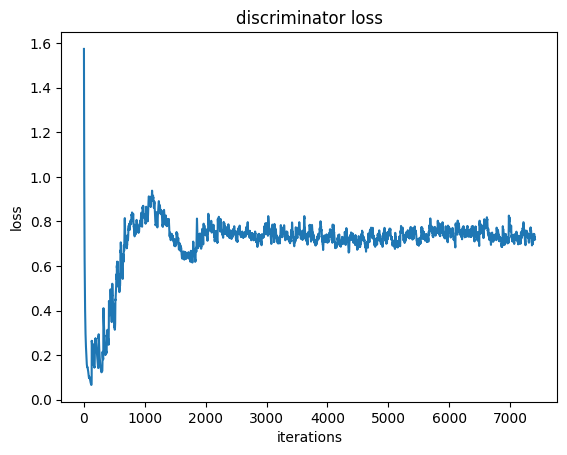

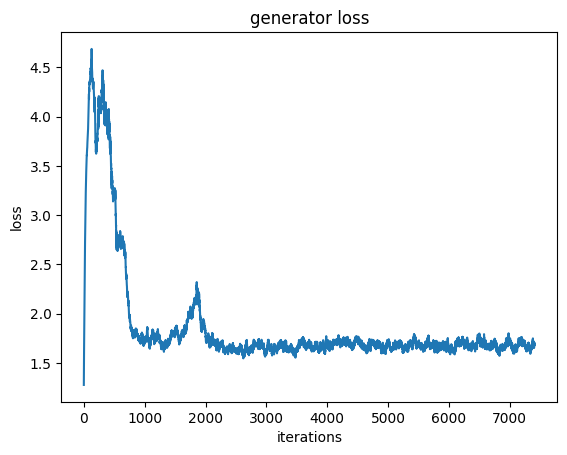

Iteration 7500/9750: dis loss = 0.6939, gen loss = 1.9843
Iteration 7600/9750: dis loss = 0.6878, gen loss = 1.9480
Iteration 7700/9750: dis loss = 0.8662, gen loss = 1.1380
Iteration 7800/9750: dis loss = 0.8099, gen loss = 1.2724
Iteration 7900/9750: dis loss = 0.7103, gen loss = 1.3928
Iteration 8000/9750: dis loss = 0.7007, gen loss = 2.1045
Iteration 8100/9750: dis loss = 0.7438, gen loss = 1.7434


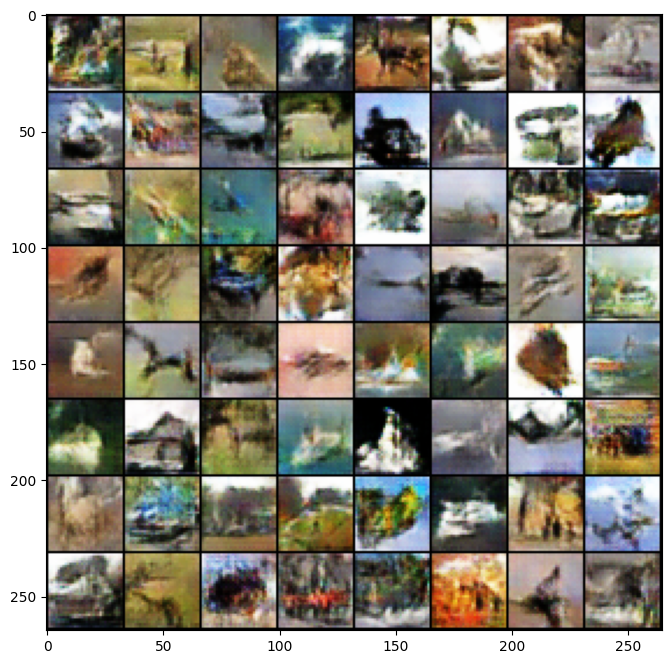

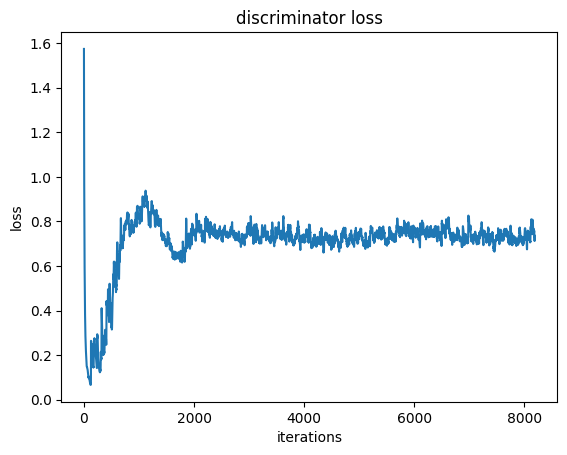

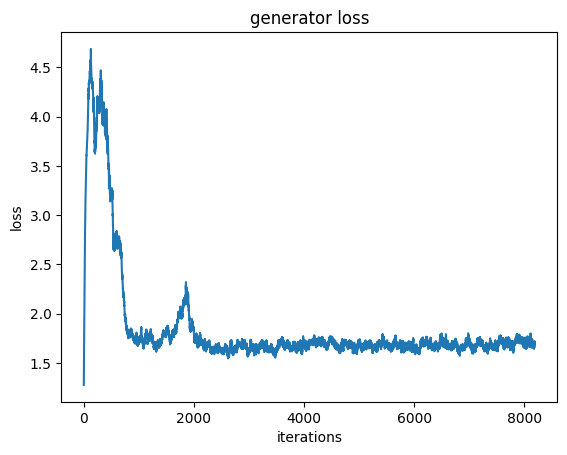

Iteration 8200/9750: dis loss = 0.5578, gen loss = 2.0734
Iteration 8300/9750: dis loss = 0.8449, gen loss = 1.1829
Iteration 8400/9750: dis loss = 0.6405, gen loss = 2.0763
Iteration 8500/9750: dis loss = 0.5532, gen loss = 1.3735
Iteration 8600/9750: dis loss = 0.6245, gen loss = 2.1024
Iteration 8700/9750: dis loss = 0.6464, gen loss = 1.9177
Iteration 8800/9750: dis loss = 0.8825, gen loss = 1.0355
Iteration 8900/9750: dis loss = 0.7203, gen loss = 1.6648


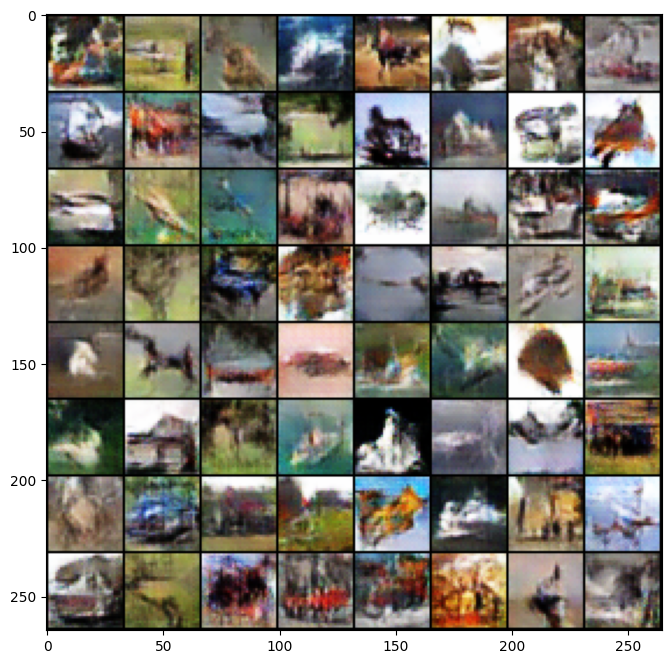

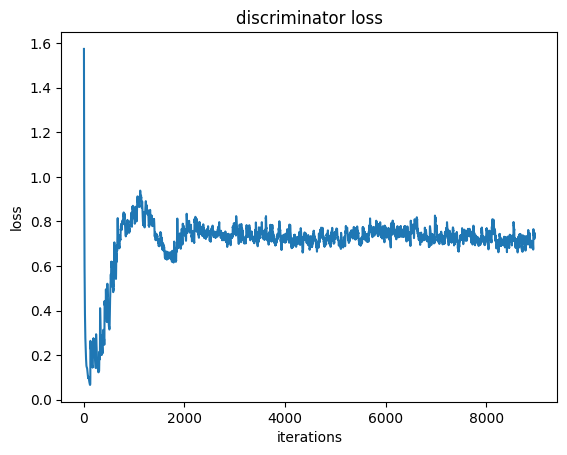

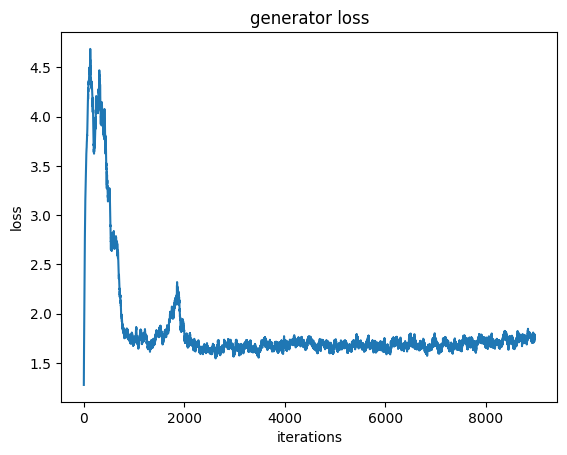

Iteration 9000/9750: dis loss = 0.6769, gen loss = 2.6414
Iteration 9100/9750: dis loss = 0.5955, gen loss = 1.4807
Iteration 9200/9750: dis loss = 0.7976, gen loss = 2.2867
Iteration 9300/9750: dis loss = 0.8627, gen loss = 1.5965
Iteration 9400/9750: dis loss = 0.6497, gen loss = 1.8947
Iteration 9500/9750: dis loss = 0.6652, gen loss = 2.2516
Iteration 9600/9750: dis loss = 1.0781, gen loss = 2.4456
Iteration 9700/9750: dis loss = 0.7370, gen loss = 1.2718


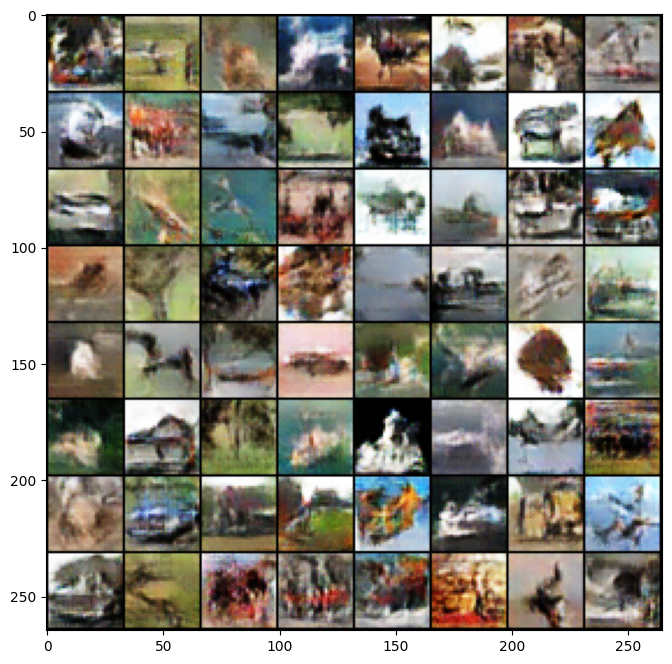

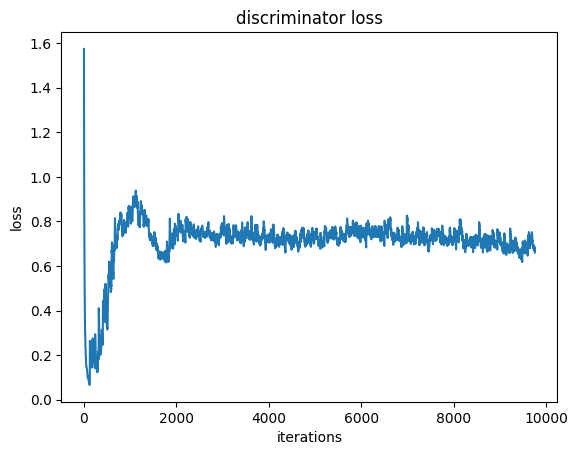

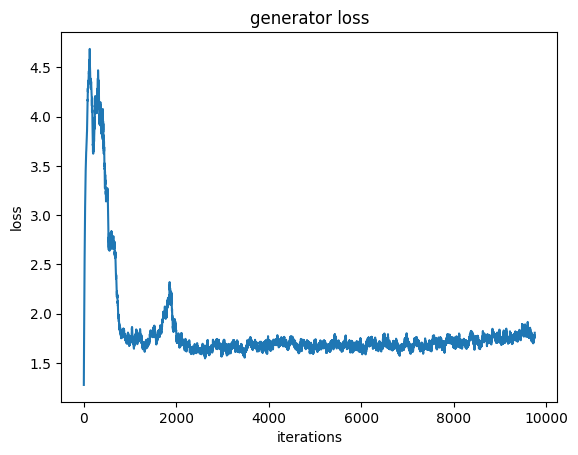

... Done!


In [9]:
set_seed(42)

dcgan = DCGAN()
dcgan.train(train_samples)
torch.save(dcgan.state_dict(), "dcgan.pt")

# **Problem 2-4: Activation Maximization (12 pts)**

Activation Maximization is a visualization technique to see what a particular neuron has learned, by finding the input that maximizes the activation of that neuron. Here we use methods similar to [Synthesizing the preferred inputs for neurons in neural networks via deep generator networks](https://urldefense.com/v3/__https://arxiv.org/abs/1605.09304__;!!LIr3w8kk_Xxm!_OyEq6RR8H2WeaK3_oOAGVDF3QgpTm6kRTMtpMyD8QNo1-3RJzf5a8G8pt5zvg$).

In short, what we want to do is to find the samples that the discriminator considers most real, among all possible outputs of the generator, which is to say, we want to find the codes (i.e. a point in the input space of the generator) from which the generated images, if labelled as real, would minimize the classification loss of the discriminator:

$$\min_{z} L(D_{\theta}(G_{\phi}(z)), 1)$$

Compare this to the objective when we were training the generator:

$$\min_{\phi} \mathrm{E}_{z \sim q(z)}[L(D_{\theta}(G_{\phi}(z)), 1)]$$

The function to minimize is the same, with the difference being that when training the network we fix a set of input data and find the optimal model parameters, while in activation maximization we fix the model parameters and find the optimal input.

So, similar to the training, we use gradient descent to solve for the optimal input. Starting from a random code (latent vector) drawn from a standard normal distribution, we perform a fixed step of Adam optimization algorithm on the code (latent vector).

The batch normalization layers should work in evaluation mode.

**We provide the code for this part, as a reference for solving the next part.** You may want to go back to the code above and check the `actmax` function and figure out what it's doing:


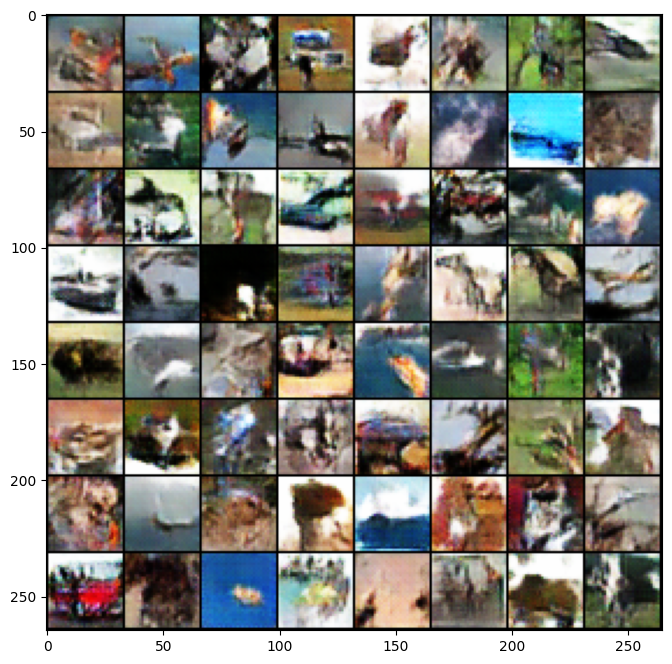

In [10]:
set_seed(241)

dcgan = DCGAN()
dcgan.load_state_dict(torch.load("dcgan.pt", map_location=device))

actmax_results = dcgan.actmax(np.random.normal(size=(64, dcgan.code_size)))
fig = plt.figure(figsize = (8, 8))   
ax1 = plt.subplot(111)
ax1.imshow(make_grid(actmax_results, padding=1, normalize=True).numpy().transpose((1, 2, 0)))
plt.show()

The output should have less variety than those generated from random code, but look realisitic.

A similar technique can be used to reconstruct a test sample, that is, to find the code that most closely approximates the test sample. To achieve this, we only need to change the loss function from discriminator's loss to the squared L2-distance between the generated image and the target image:

$$\min_{z} \left|\left|G_{\phi}(z)-x\right|\right|_2^2$$

This time, we always start from a zero vector.


## **For this part, you need to complete code blocks marked with "Prob 2-4" above.** Then run the following block.

**You need to achieve a reconstruction loss < 0.145. Do NOT modify anything outside of the blocks marked for you to fill in.**

average reconstruction loss = 0.0139


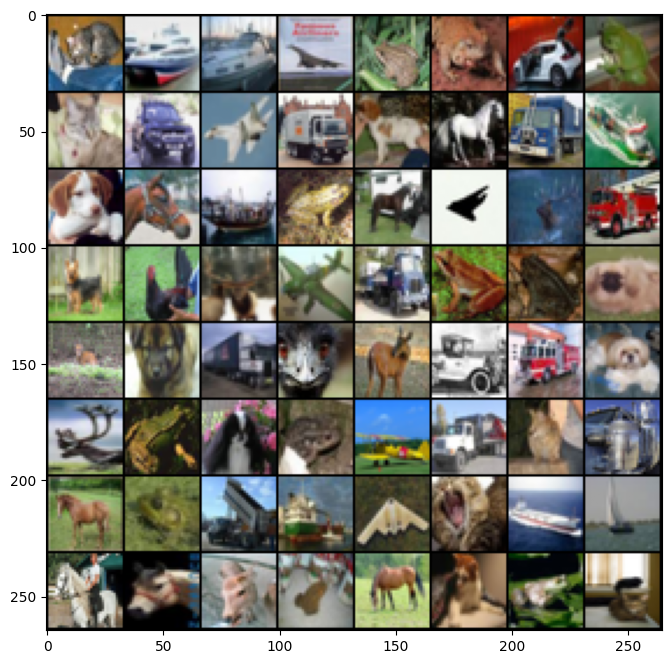

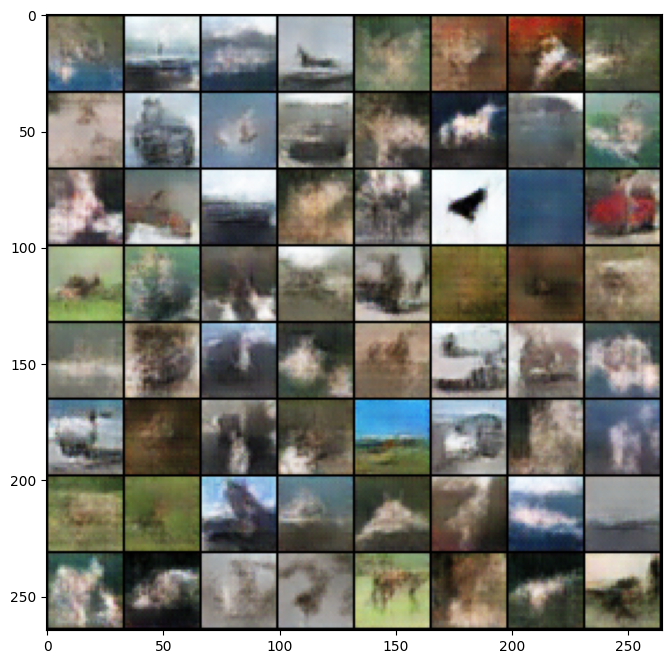

In [11]:
dcgan = DCGAN()
dcgan.load_state_dict(torch.load("dcgan.pt", map_location=device))

avg_loss, reconstructions = dcgan.reconstruct(test_samples[0:64])
print('average reconstruction loss = {0:.4f}'.format(avg_loss))
fig = plt.figure(figsize = (8, 8))   
ax1 = plt.subplot(111)
ax1.imshow(make_grid(torch.from_numpy(test_samples[0:64]), padding=1).numpy().transpose((1, 2, 0)))
plt.show()
fig = plt.figure(figsize = (8, 8))   
ax1 = plt.subplot(111)
ax1.imshow(make_grid(reconstructions, padding=1, normalize=True).numpy().transpose((1, 2, 0)))
plt.show()

# **Submission Instruction**

See the pinned Piazza post for detailed instruction.